In [13]:
library(tidyverse)
library(tidyr)
library(ggsankey)

In [3]:
count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

In [3]:
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
sb_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
sb_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

Rows: 1474 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 1481 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 20 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3):

In [4]:
head(sb_ctr_acrs_rep1_file)

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
Chr03,11930874,11931375,"scACR_21953;mesophyll_n_cell_3909,protoderm_n_cell_2245",0;
Chr03,11930874,11931375,"scACR_21953;mesophyll_n_cell_3909,protoderm_n_cell_2245",0;
Chr03,47269122,47269623,"scACR_22823;bundle_sheath_n_cell_1777,unknown_desc_1_n_cell_832",0;
Chr03,47269122,47269623,"scACR_22823;bundle_sheath_n_cell_1777,unknown_desc_1_n_cell_832",0;
Chr03,57266671,57267172,"scACR_23107;bundle_sheath_n_cell_1777,protoderm_n_cell_2245",2e-05;
Chr03,57266671,57267172,"scACR_23107;bundle_sheath_n_cell_1777,protoderm_n_cell_2245",0;


In [5]:
sb_acrs_rep1 <- count_function(sb_cts_acrs_rep1_file,sb_ctr_acrs_rep1_file, sb_broadly_acc_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
sb_acrs_rep2 <- count_function(sb_cts_acrs_rep2_file, sb_ctr_acrs_rep2_file, sb_broadly_acc_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

In [6]:
joined_sb_replicates <- full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


In [7]:
other<- full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))

In [8]:
other  %>% 
    dplyr::filter(cell_type.rep1 != cell_type.rep2)  %>% 
    sample_n(10)

chrom,start,stop,acr,cell_type.rep1,pval.rep1,rep.rep1,cell_type.rep2,pval.rep2,rep.rep2
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>,<chr>,<fct>,<chr>
Chr04,4847770,4848271,scACR_29340,broadly_accessible,NA,rep1,companion_cells_sieve_elements_n_cell_562,8e-06,rep2
Chr07,65606047,65606548,scACR_49344,epidermis_n_cell_4214,0,rep1,broadly_accessible,NA,rep2
Chr09,54663295,54663796,scACR_57054,broadly_accessible,NA,rep1,bundle_sheath_n_cell_1777,0,rep2
Chr02,71267231,71267732,scACR_17340,bundle_sheath_n_cell_1777,0,rep1,broadly_accessible,NA,rep2
Chr08,5837088,5837589,scACR_51175,bundle_sheath_n_cell_1777,0,rep1,broadly_accessible,NA,rep2
Chr04,54302779,54303280,scACR_31670,broadly_accessible,NA,rep1,companion_cells_sieve_elements_n_cell_562,4.2e-05,rep2
Chr06,57444557,57445058,scACR_44194,procambial_meristem_n_cell_564,2.8e-05,rep1,broadly_accessible,NA,rep2
Chr10,9027026,9027527,scACR_60946,companion_cells_sieve_elements_n_cell_562,0,rep1,broadly_accessible,NA,rep2
Chr03,72926639,72927140,scACR_26265,broadly_accessible,NA,rep1,procambial_meristem_n_cell_564,7.6e-05,rep2


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


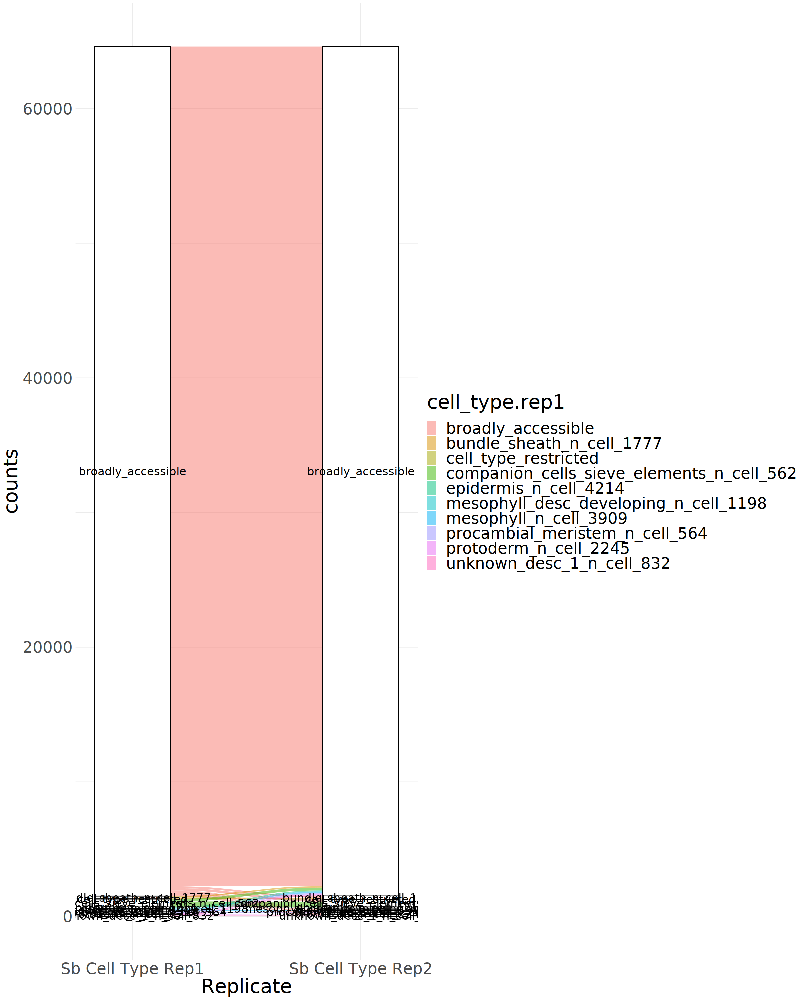

In [9]:

library(ggalluvial)


options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_sb_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))


In [10]:
joined_sb_replicates

cell_type.rep1,rep.rep1,cell_type.rep2,rep.rep2,counts
<chr>,<chr>,<chr>,<chr>,<int>
broadly_accessible,rep1,broadly_accessible,rep2,62384
broadly_accessible,rep1,bundle_sheath_n_cell_1777,rep2,138
broadly_accessible,rep1,cell_type_restricted,rep2,4
broadly_accessible,rep1,companion_cells_sieve_elements_n_cell_562,rep2,171
broadly_accessible,rep1,epidermis_n_cell_4214,rep2,42
broadly_accessible,rep1,mesophyll_desc_developing_n_cell_1198,rep2,46
broadly_accessible,rep1,mesophyll_n_cell_3909,rep2,69
broadly_accessible,rep1,procambial_meristem_n_cell_564,rep2,97
broadly_accessible,rep1,protoderm_n_cell_2245,rep2,85


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


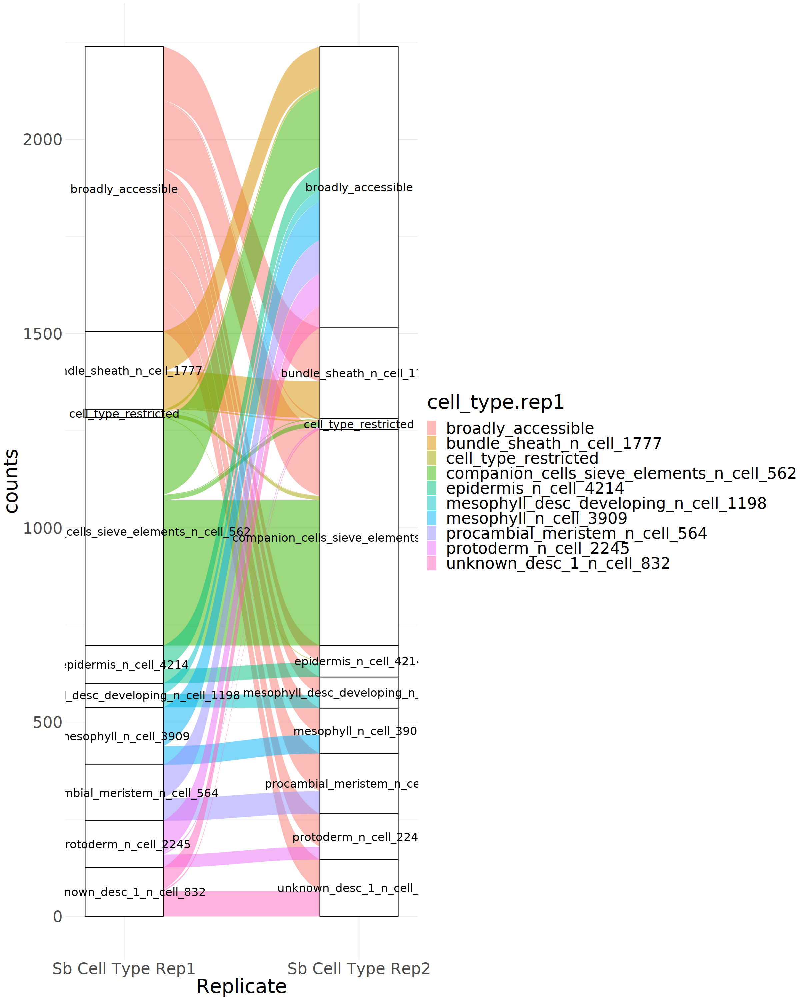

In [11]:

library(ggalluvial)


options(repr.plot.width=20, repr.plot.height=25) 

joined_sb_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))


In [12]:
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file, zm_broadly_acc_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file, zm_broadly_acc_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

other<- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))

other  %>% 
    dplyr::filter(cell_type.rep1 != cell_type.rep2)  %>% 
    mutate()


library(ggalluvial)

Rows: 644 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 485 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 105 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): 

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr1,24342107,24342608,"scACR_1122;phloem_sieve_elements_n_cell_1471,protoderm_n_cell_2021",0;
chr1,24342107,24342608,"scACR_1122;phloem_sieve_elements_n_cell_1471,protoderm_n_cell_2021",2e-06;
chr10,145007927,145008428,"scACR_12286;epidermis_n_cell_3488,protoderm_n_cell_2021",0;
chr10,145007927,145008428,"scACR_12286;epidermis_n_cell_3488,protoderm_n_cell_2021",0;
chr2,113820824,113821325,"scACR_15970;epidermis_n_cell_3488,protoderm_n_cell_2021",0;
chr2,113820824,113821325,"scACR_15970;epidermis_n_cell_3488,protoderm_n_cell_2021",0;


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


chrom,start,stop,acr,cell_type.rep1,pval.rep1,rep.rep1,cell_type.rep2,pval.rep2,rep.rep2
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>,<chr>,<fct>,<chr>
chr10,95013092,95013593,scACR_10691,bundle_sheath_n_cell_2878,2e-05,rep1,broadly_accessible,NA,rep2
chr10,116487265,116487766,scACR_11173,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2
chr2,7228413,7228914,scACR_13205,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2
chr1,3949299,3949800,scACR_154,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2
chr1,37685796,37686297,scACR_1643,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2
chr3,7183468,7183969,scACR_19744,bundle_sheath_n_cell_2878,2.6e-05,rep1,broadly_accessible,NA,rep2
chr1,46287945,46288446,scACR_1997,bundle_sheath_n_cell_2878,0,rep1,procambial_meristem_n_cell_346,0,rep2
chr3,50691002,50691503,scACR_20977,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2
chr3,93046714,93047215,scACR_21403,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


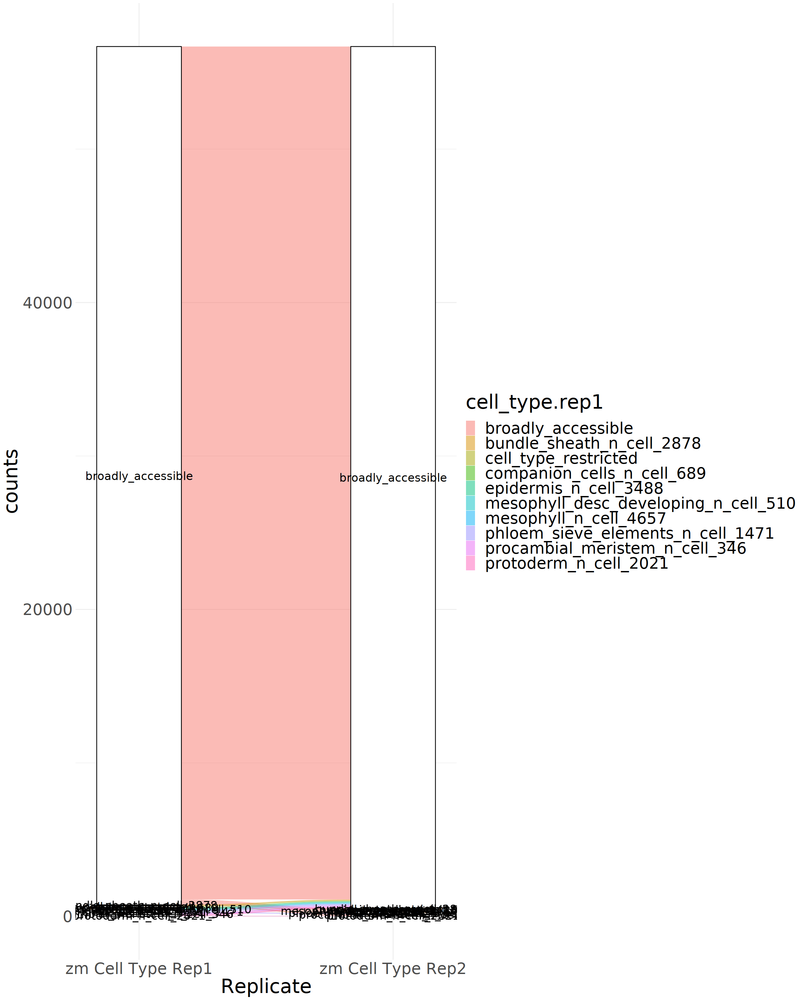

In [13]:
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


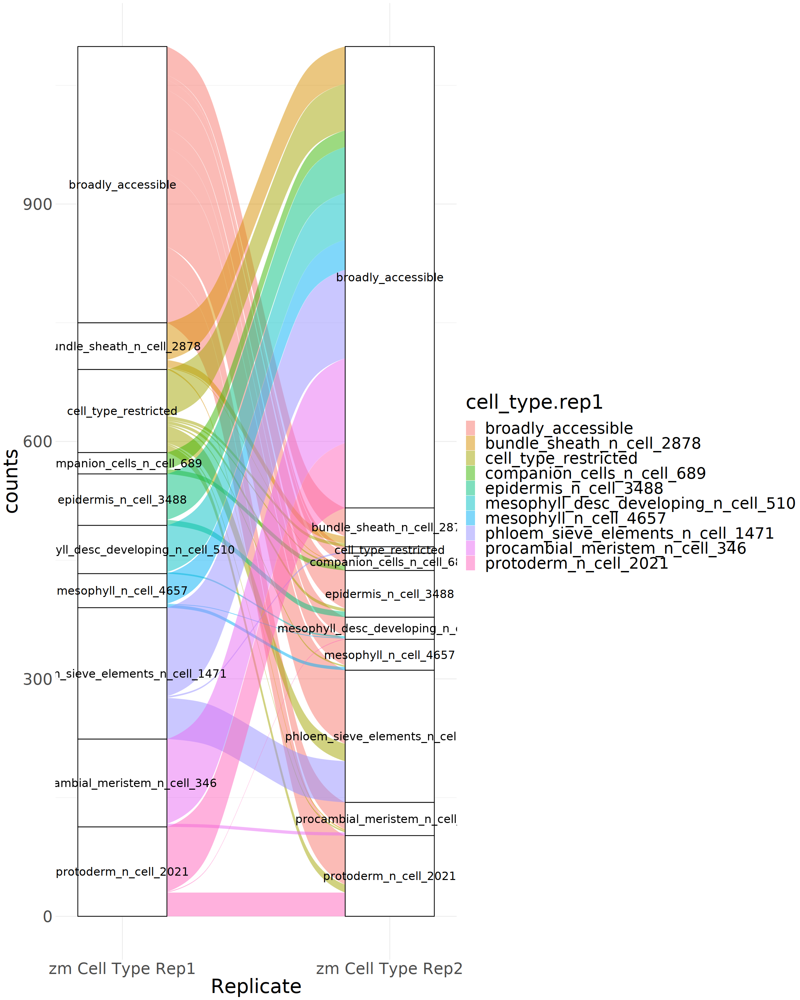

In [14]:
options(repr.plot.width=20, repr.plot.height=25) 

joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

# Run Replicates Quantile Normalized

Rows: 4379 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 4483 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 260 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3)

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
Chr01,84912081,84912582,"scACR_11433;protoderm_n_cell_2245,unknown_desc_1_n_cell_832",0.006842;
Chr01,84912081,84912582,"scACR_11433;protoderm_n_cell_2245,unknown_desc_1_n_cell_832",0.0092;
Chr02,2054008,2054509,"scACR_11810;bundle_sheath_n_cell_1777,procambial_meristem_n_cell_564",0.000866;
Chr02,2054008,2054509,"scACR_11810;bundle_sheath_n_cell_1777,procambial_meristem_n_cell_564",0.004552;
Chr02,5595487,5595988,"scACR_12494;companion_cells_sieve_elements_n_cell_562,mesophyll_n_cell_3909",0.005516;
Chr02,5595487,5595988,"scACR_12494;companion_cells_sieve_elements_n_cell_562,mesophyll_n_cell_3909",0.001728;


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


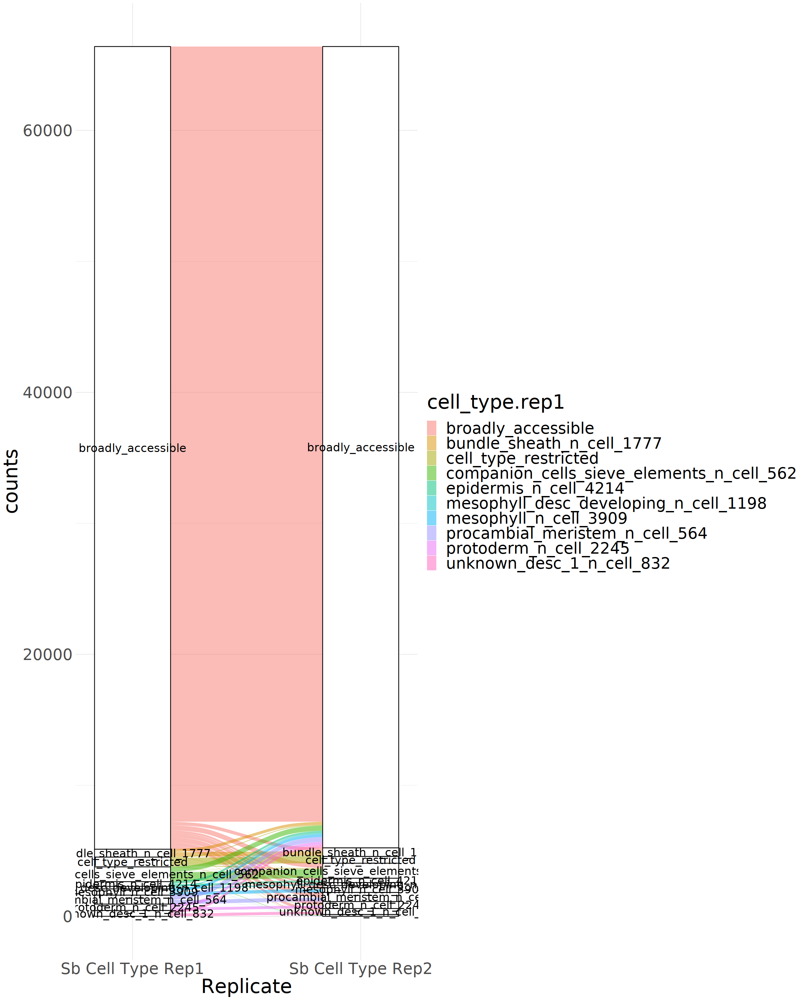

In [15]:
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")

sb_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.quantile.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
sb_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.quantile.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.quantile.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.quantile.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.quantile.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.quantile.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(sb_ctr_acrs_rep1_file)

count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

sb_acrs_rep1 <- count_function(sb_cts_acrs_rep1_file,sb_ctr_acrs_rep1_file, sb_broadly_acc_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
sb_acrs_rep2 <- count_function(sb_cts_acrs_rep2_file, sb_ctr_acrs_rep2_file, sb_broadly_acc_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_sb_replicates <- full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

other<- full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))


library(ggalluvial)


options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_sb_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


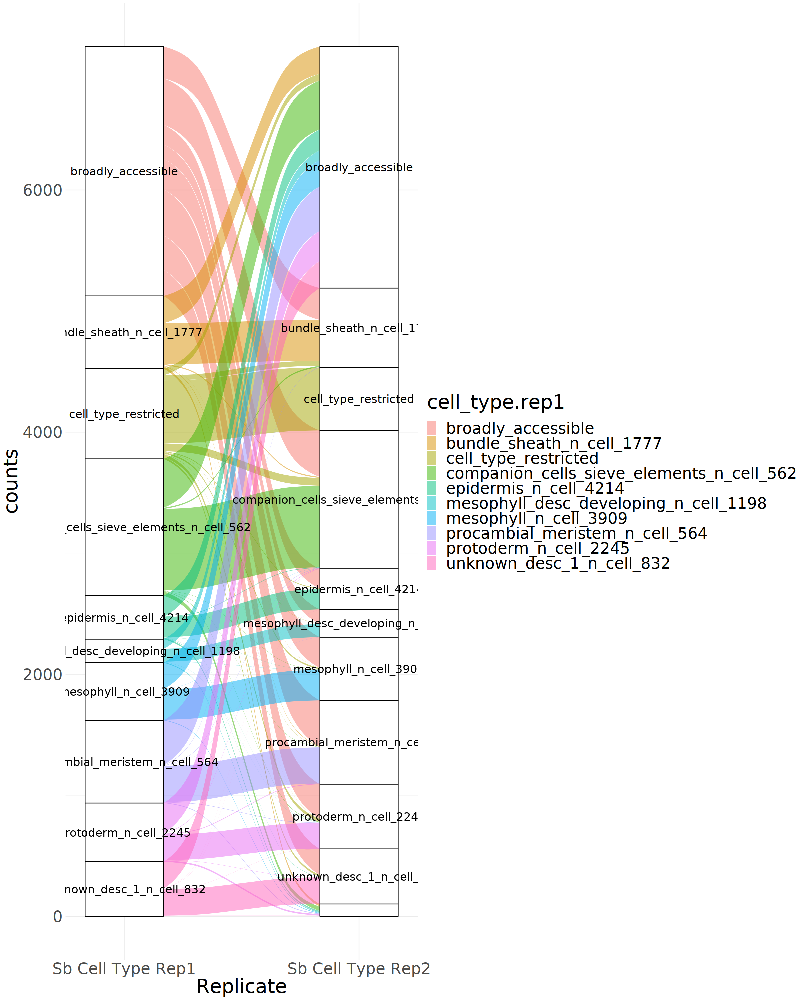

In [16]:
options(repr.plot.width=20, repr.plot.height=25) 

joined_sb_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [17]:
joined_sb_replicates

cell_type.rep1,rep.rep1,cell_type.rep2,rep.rep2,counts
<chr>,<chr>,<chr>,<chr>,<int>
broadly_accessible,rep1,broadly_accessible,rep2,59179
broadly_accessible,rep1,bundle_sheath_n_cell_1777,rep2,263
broadly_accessible,rep1,companion_cells_sieve_elements_n_cell_562,rep2,384
broadly_accessible,rep1,epidermis_n_cell_4214,rep2,162
broadly_accessible,rep1,mesophyll_desc_developing_n_cell_1198,rep2,119
broadly_accessible,rep1,mesophyll_n_cell_3909,rep2,253
broadly_accessible,rep1,procambial_meristem_n_cell_564,rep2,379
broadly_accessible,rep1,protoderm_n_cell_2245,rep2,285
broadly_accessible,rep1,unknown_desc_1_n_cell_832,rep2,215


In [18]:
other  %>% 
    dplyr::filter(cell_type.rep1 != cell_type.rep2)  %>% 
    sample_n(10)



chrom,start,stop,acr,cell_type.rep1,pval.rep1,rep.rep1,cell_type.rep2,pval.rep2,rep.rep2
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>,<chr>,<fct>,<chr>
Chr07,4644802,4645303,scACR_47258,broadly_accessible,NA,rep1,procambial_meristem_n_cell_564,0.00514,rep2
Chr05,1000058,1000559,scACR_36552,protoderm_n_cell_2245,0.009978,rep1,broadly_accessible,NA,rep2
Chr04,59672302,59672803,scACR_33362,cell_type_restricted,0.009324;,rep1,bundle_sheath_n_cell_1777,0.00465,rep2
Chr07,59810944,59811445,scACR_49114,bundle_sheath_n_cell_1777,0.00194,rep1,broadly_accessible,NA,rep2
Chr04,68962467,68962968,scACR_35799,broadly_accessible,NA,rep1,protoderm_n_cell_2245,0,rep2
Chr10,57305656,57306157,scACR_64474,companion_cells_sieve_elements_n_cell_562,9e-05,rep1,broadly_accessible,NA,rep2
Chr01,79182598,79183099,scACR_10016,broadly_accessible,NA,rep1,bundle_sheath_n_cell_1777,0.004904,rep2
Chr03,71144531,71145032,scACR_26301,protoderm_n_cell_2245,0.006598,rep1,broadly_accessible,NA,rep2
Chr02,8858861,8859362,scACR_12910,unknown_desc_1_n_cell_832,0.000922,rep1,broadly_accessible,NA,rep2


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


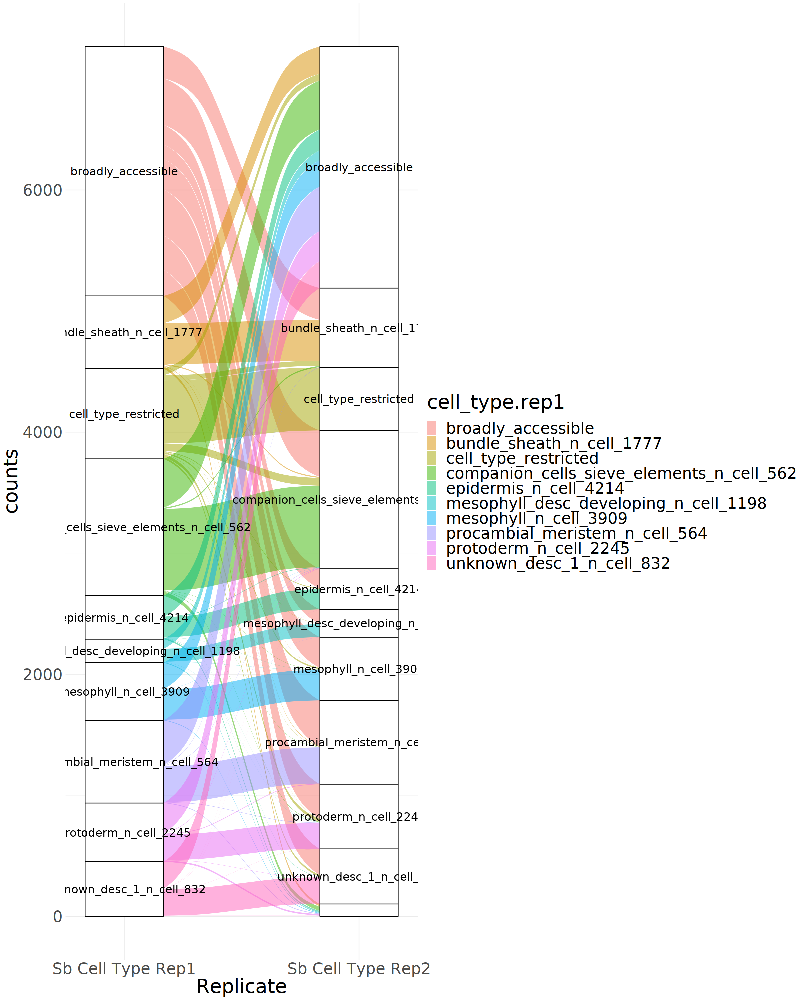

In [19]:

library(ggalluvial)


options(repr.plot.width=20, repr.plot.height=25) 

joined_sb_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))


In [20]:
### Zm
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.quantileall_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.quantileall_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.quantileall_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.quantileall_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.quantilebroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.quantilebroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file, zm_broadly_acc_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file, zm_broadly_acc_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

other<- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))

other  %>% 
    dplyr::filter(cell_type.rep1 != cell_type.rep2)  %>% 
    mutate()

Rows: 2370 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 1877 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 611 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3)

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr10,78351385,78351886,"scACR_10012;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657",2.4e-05;
chr10,78351385,78351886,"scACR_10012;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657",0.002174;
chr10,83430504,83431005,"scACR_10151;companion_cells_n_cell_689,protoderm_n_cell_2021",0.002716;
chr10,83430504,83431005,"scACR_10151;companion_cells_n_cell_689,protoderm_n_cell_2021",0;
chr1,23174008,23174509,"scACR_1022;epidermis_n_cell_3488,protoderm_n_cell_2021",0;
chr1,23174008,23174509,"scACR_1022;epidermis_n_cell_3488,protoderm_n_cell_2021",0.000546;


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


chrom,start,stop,acr,cell_type.rep1,pval.rep1,rep.rep1,cell_type.rep2,pval.rep2,rep.rep2
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>,<chr>,<fct>,<chr>
chr10,95013092,95013593,scACR_10440,bundle_sheath_n_cell_2878,3.4e-05,rep1,broadly_accessible,NA,rep2
chr1,24089857,24090358,scACR_1066,bundle_sheath_n_cell_2878,0.003802,rep1,broadly_accessible,NA,rep2
chr10,116487265,116487766,scACR_10920,bundle_sheath_n_cell_2878,0,rep1,broadly_accessible,NA,rep2
chr1,27045441,27045942,scACR_1162,bundle_sheath_n_cell_2878,0.00018,rep1,broadly_accessible,NA,rep2
chr10,140007497,140007998,scACR_11751,bundle_sheath_n_cell_2878,0.001184,rep1,procambial_meristem_n_cell_346,0.003116,rep2
chr10,147562898,147563399,scACR_12159,bundle_sheath_n_cell_2878,0.007588,rep1,broadly_accessible,NA,rep2
chr2,10293487,10293988,scACR_13064,bundle_sheath_n_cell_2878,0.002274,rep1,mesophyll_desc_developing_n_cell_510,0.005154,rep2
chr2,19011723,19012224,scACR_13565,bundle_sheath_n_cell_2878,0.003748,rep1,broadly_accessible,NA,rep2
chr2,41776627,41777128,scACR_14402,bundle_sheath_n_cell_2878,0.000298,rep1,broadly_accessible,NA,rep2


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


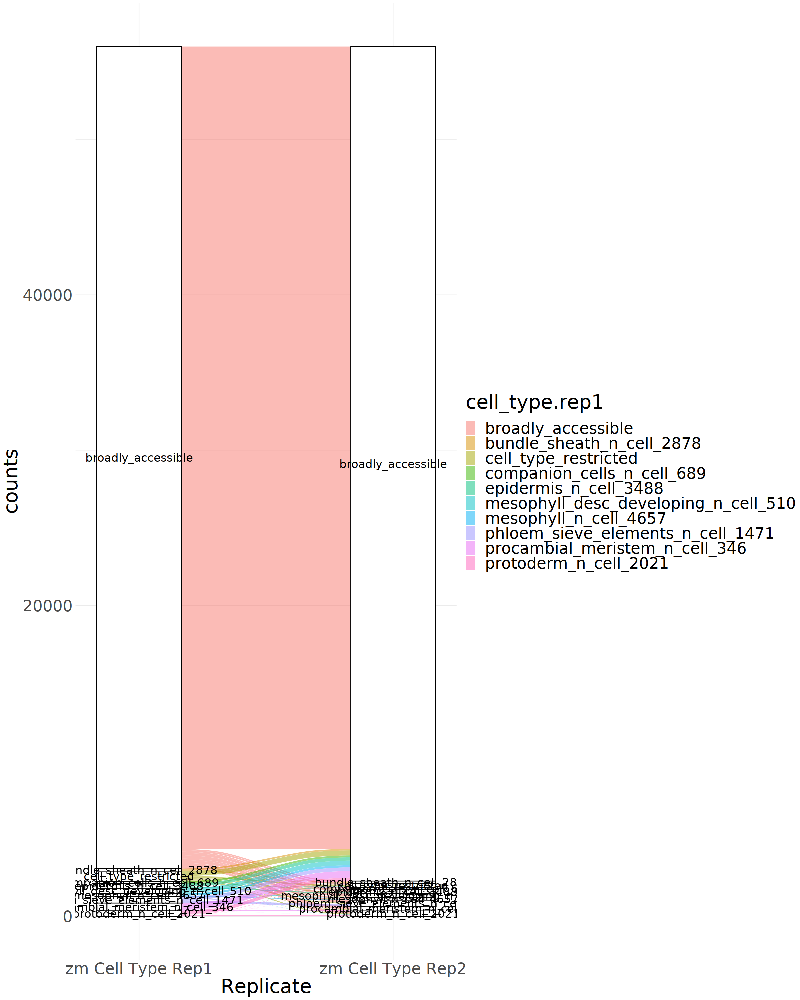

In [21]:
library(ggalluvial)

options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


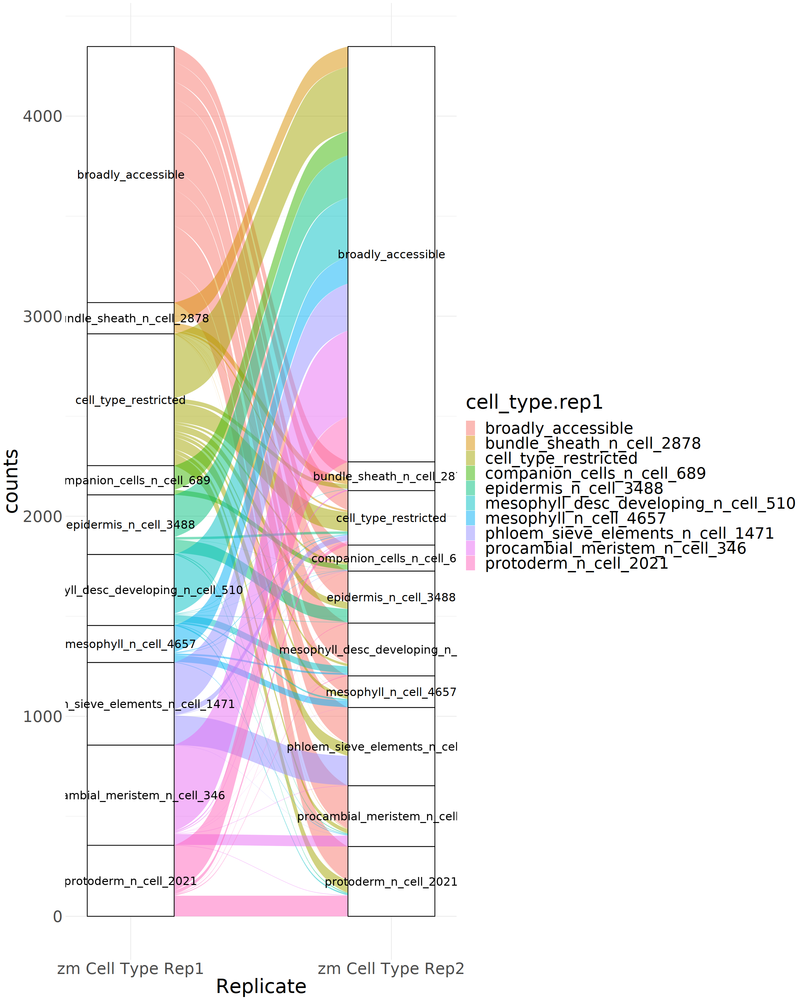

In [22]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

# Updated methods 3/7/2023
# Documentation here: https://github.com/Jome0169/Mendieta_et_al_comparative_single_cell/issues/37 

Rows: 13142 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 13076 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 7803 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr 

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
Chr01,79118648,79119149,"scACR_10000;mesophyll_desc_developing_n_cell_1198,unknown_desc_1_n_cell_832","0.02437,0.099634"
Chr01,79143724,79144225,"scACR_10010;epidermis_n_cell_4214,unknown_desc_1_n_cell_832","0.086204,0.055694"
Chr01,79147384,79147885,"scACR_10011;mesophyll_desc_developing_n_cell_1198,unknown_desc_1_n_cell_832","0.099112,0.000846"
Chr01,79200805,79201306,"scACR_10021;mesophyll_desc_developing_n_cell_1198,procambial_meristem_n_cell_564","0.000416,0.01285"
Chr01,79202195,79202696,"scACR_10022;mesophyll_desc_developing_n_cell_1198,procambial_meristem_n_cell_564","0.002052,0.004148"
Chr01,79202890,79203391,"scACR_10023;mesophyll_desc_developing_n_cell_1198,procambial_meristem_n_cell_564","0.018726,0.05888"


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


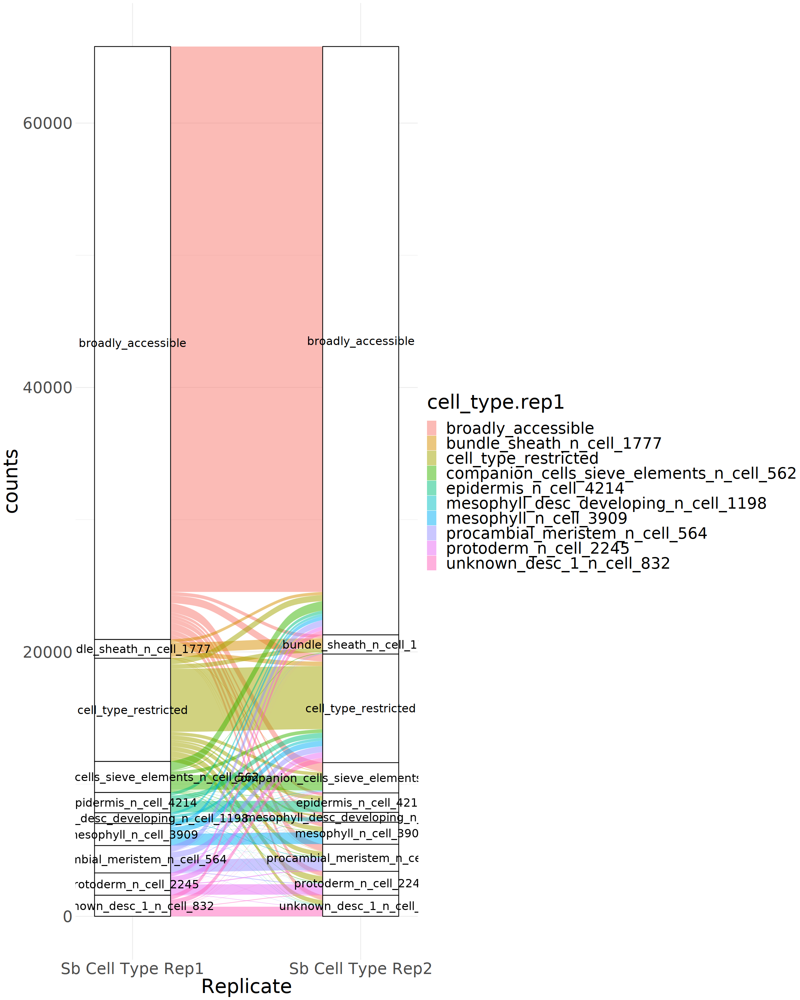

In [23]:
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")

sb_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.updated.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
sb_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.updated.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.updated.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.updated.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep1.updated.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.rep2.updated.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(sb_ctr_acrs_rep1_file)

count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

sb_acrs_rep1 <- count_function(sb_cts_acrs_rep1_file,sb_ctr_acrs_rep1_file, sb_broadly_acc_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
sb_acrs_rep2 <- count_function(sb_cts_acrs_rep2_file, sb_ctr_acrs_rep2_file, sb_broadly_acc_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_sb_replicates <- full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

other<- full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))


library(ggalluvial)
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_sb_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [24]:
sb_acrs_rep2  %>% 
    dplyr::filter(acr == "scACR_10998")

chrom,start,stop,acr,cell_type,pval,rep
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>
Chr01,83179820,83180321,scACR_10998,cell_type_restricted,"0.018926,0.037292",rep2


In [25]:
joined_sb_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible")

cell_type.rep1,rep.rep1,cell_type.rep2,rep.rep2,counts
<chr>,<chr>,<chr>,<chr>,<int>
broadly_accessible,rep1,bundle_sheath_n_cell_1777,rep2,263
broadly_accessible,rep1,cell_type_restricted,rep2,577
broadly_accessible,rep1,companion_cells_sieve_elements_n_cell_562,rep2,699
broadly_accessible,rep1,epidermis_n_cell_4214,rep2,227
broadly_accessible,rep1,mesophyll_desc_developing_n_cell_1198,rep2,210
broadly_accessible,rep1,mesophyll_n_cell_3909,rep2,341
broadly_accessible,rep1,procambial_meristem_n_cell_564,rep2,538
broadly_accessible,rep1,protoderm_n_cell_2245,rep2,366
broadly_accessible,rep1,unknown_desc_1_n_cell_832,rep2,370


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


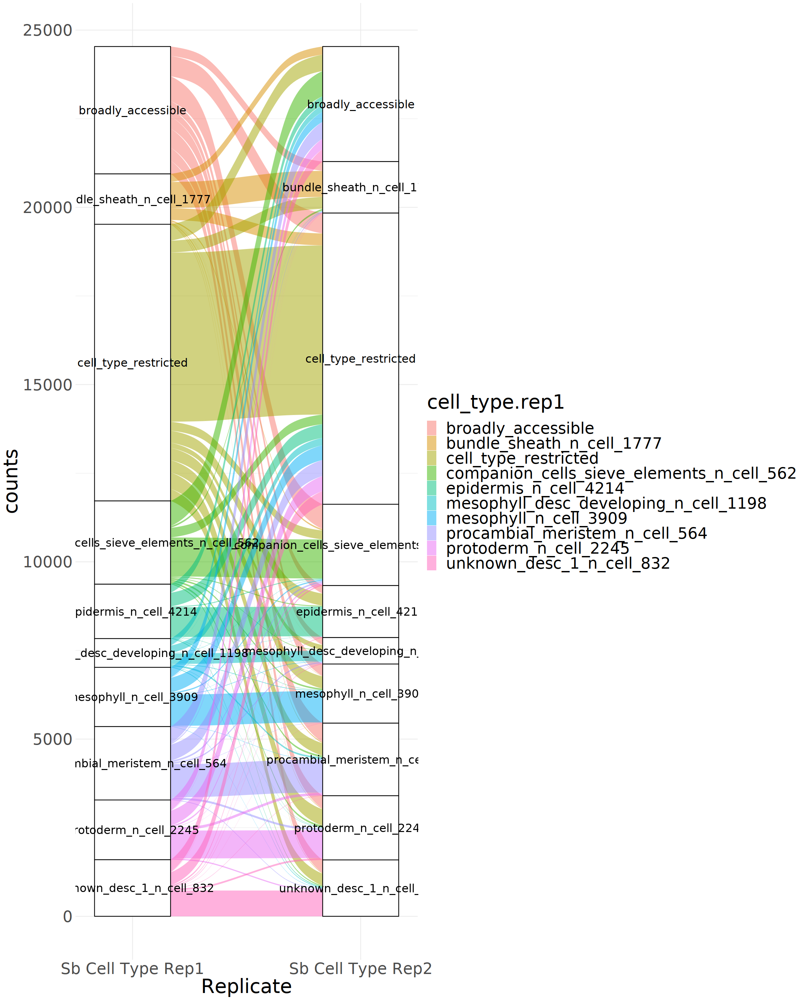

In [26]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_sb_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    ggplot(data = .,
       aes(axis1 = cell_type.rep1, 
           axis2 = cell_type.rep2,
           y = counts)) +
      scale_x_discrete(limits = c("Sb Cell Type Rep1", "Sb Cell Type Rep2"), expand = c(.2, .05)) +
      xlab("Replicate") +
      geom_alluvium(aes(fill = cell_type.rep1)) +
      geom_stratum() +
      geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
      theme_minimal() + theme(text = element_text(size = 35))

In [27]:
sb_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.no_exons.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
sb_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.no_exons.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
sb_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/sb/Sb.final_acr_classification.no_exons.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
sb_merged_rep_counts <- count_function(sb_cts_acrs_rep1_file, sb_ctr_acrs_rep1_file,sb_broadly_acc_acrs_rep1_file)


Rows: 12816 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 10200 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): chrom, acr_name_type, pval
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 42772 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr

In [28]:
head(sb_merged_rep_counts)

chrom,start,stop,acr,cell_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>
Chr01,79582374,79582875,scACR_10115,bundle_sheath_n_cell_1777,0.013748
Chr01,79666935,79667436,scACR_10144,bundle_sheath_n_cell_1777,0.00468
Chr01,79711523,79712024,scACR_10157,bundle_sheath_n_cell_1777,0.086936
Chr01,80835950,80836451,scACR_10409,bundle_sheath_n_cell_1777,0
Chr01,80982393,80982894,scACR_10450,bundle_sheath_n_cell_1777,0.091432
Chr01,81278929,81279430,scACR_10510,bundle_sheath_n_cell_1777,0.08977


In [29]:
sb_combined_reps <- sb_merged_rep_counts  %>% 
    group_by(cell_type)  %>% 
    summarise(counts_n_acrs = n())

sb_combined_reps

sb_switching_quant <-  full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())


sb_switching_quant_ct <-  full_join(sb_acrs_rep1, sb_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())  %>% 
    dplyr::filter(cell_type.rep1 == cell_type.rep2)  %>% 
    left_join(., sb_combined_reps, by = c("cell_type.rep1" = "cell_type"))  %>% 
    mutate(proportion_conserved = counts/counts_n_acrs)

sb_switching_quant_ct

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,42772
bundle_sheath_n_cell_1777,1444
cell_type_restricted,10200
companion_cells_sieve_elements_n_cell_562,2183
epidermis_n_cell_4214,1538
mesophyll_desc_developing_n_cell_1198,690
mesophyll_n_cell_3909,1813
procambial_meristem_n_cell_564,1817
protoderm_n_cell_2245,1822


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


cell_type.rep1,rep.rep1,cell_type.rep2,rep.rep2,counts,counts_n_acrs,proportion_conserved
<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>
broadly_accessible,rep1,broadly_accessible,rep2,41252,42772,0.9644627
bundle_sheath_n_cell_1777,rep1,bundle_sheath_n_cell_1777,rep2,734,1444,0.5083102
cell_type_restricted,rep1,cell_type_restricted,rep2,4770,10200,0.4676471
companion_cells_sieve_elements_n_cell_562,rep1,companion_cells_sieve_elements_n_cell_562,rep2,1101,2183,0.5043518
epidermis_n_cell_4214,rep1,epidermis_n_cell_4214,rep2,836,1538,0.5435631
mesophyll_desc_developing_n_cell_1198,rep1,mesophyll_desc_developing_n_cell_1198,rep2,291,690,0.4217391
mesophyll_n_cell_3909,rep1,mesophyll_n_cell_3909,rep2,882,1813,0.4864865
procambial_meristem_n_cell_564,rep1,procambial_meristem_n_cell_564,rep2,934,1817,0.5140341
protoderm_n_cell_2245,rep1,protoderm_n_cell_2245,rep2,786,1822,0.4313941


In [30]:
### Zm
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedall_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedall_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedall_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedall_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file, zm_broadly_acc_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file, zm_broadly_acc_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

Rows: 8730 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 8993 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 5437 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr10,78351385,78351886,"scACR_10012;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","0.00986,0.050048"
chr10,78425071,78425572,"scACR_10017;mesophyll_desc_developing_n_cell_510,protoderm_n_cell_2021","0.035124,0.050528"
chr1,22686249,22686750,"scACR_1002;companion_cells_n_cell_689,procambial_meristem_n_cell_346","0.063902,0.086966"
chr10,78831180,78831681,"scACR_10040;epidermis_n_cell_3488,procambial_meristem_n_cell_346","0.074236,0.051262"
chr10,79338250,79338751,"scACR_10044;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","0.094122,0.043844"
chr10,79595625,79596126,"scACR_10054;bundle_sheath_n_cell_2878,mesophyll_n_cell_4657","0.073136,0.00982"


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


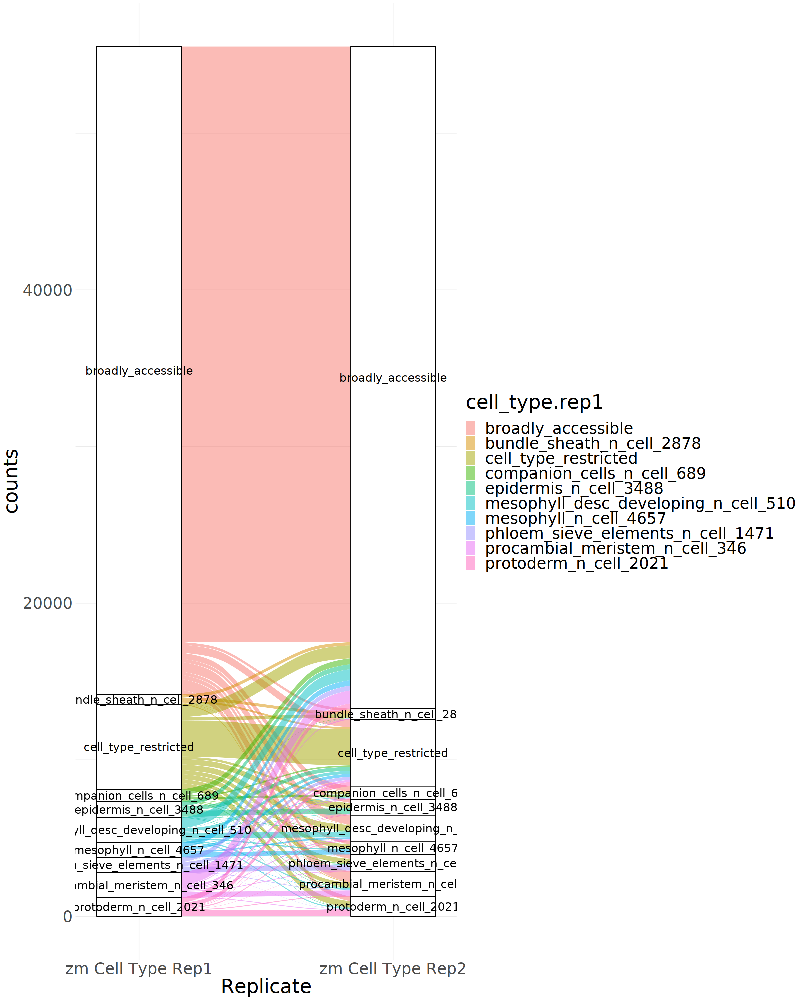

In [31]:
library(ggalluvial)
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


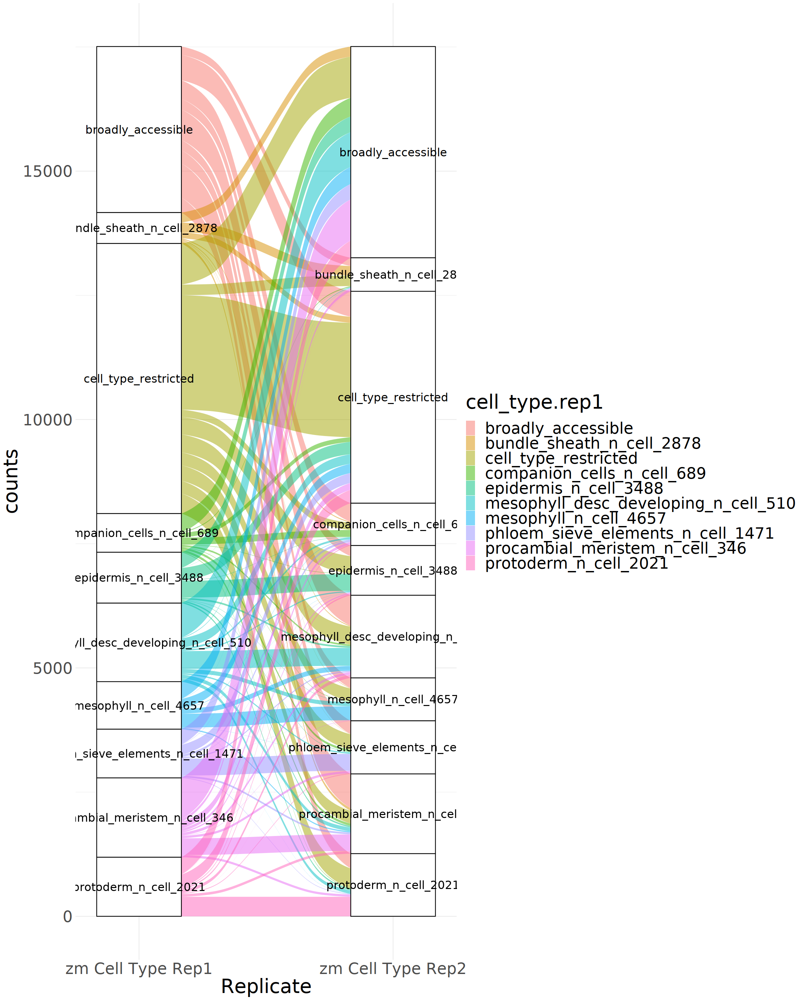

In [32]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [33]:
zm_cts_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.no_exons.final.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.no_exons.final.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.no_exons.final.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_merged_rep_counts <- count_function(zm_cts_acrs_pool_file, zm_ctr_acrs_pool_file,zm_broadly_acc_acrs_pool_file)


Rows: 8852 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 6934 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): chrom, acr_name_type, pval
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 39757 Columns: 5
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (

In [36]:
zm_combined_rep <- zm_merged_rep_counts  %>% 
    group_by(cell_type)  %>% 
    summarise(counts_n_acrs = n())
zm_combined_rep

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,39757
bundle_sheath_n_cell_2878,721
cell_type_restricted,6934
companion_cells_n_cell_689,709
epidermis_n_cell_3488,1090
mesophyll_desc_developing_n_cell_510,1463
mesophyll_n_cell_4657,1025
phloem_sieve_elements_n_cell_1471,1026
procambial_meristem_n_cell_346,1503


In [37]:
zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())


In [40]:
zm_switching_quant

classification,counts
<chr>,<int>
conserved,42710
switching,12833


In [41]:
zm_switching_quant_ct <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    group_by(cell_type.rep1, cell_type.rep2)  %>% 
    summarise(counts = n())  %>% 
    dplyr::filter(cell_type.rep1 == cell_type.rep2)  %>% 
    ungroup()  %>% 
    left_join(., zm_combined_rep, by = c("cell_type.rep1" = "cell_type"))  %>% 
    mutate(proportion_conserved = counts/counts_n_acrs)

zm_switching_quant_ct

`summarise()` has grouped output by 'cell_type.rep1'. You can override using the `.groups` argument.


cell_type.rep1,cell_type.rep2,counts,counts_n_acrs,proportion_conserved
<chr>,<chr>,<int>,<int>,<dbl>
broadly_accessible,broadly_accessible,38035,39757,0.9566869
bundle_sheath_n_cell_2878,bundle_sheath_n_cell_2878,191,721,0.2649098
cell_type_restricted,cell_type_restricted,2303,6934,0.3321315
companion_cells_n_cell_689,companion_cells_n_cell_689,138,709,0.1946403
epidermis_n_cell_3488,epidermis_n_cell_3488,338,1090,0.3100917
mesophyll_desc_developing_n_cell_510,mesophyll_desc_developing_n_cell_510,359,1463,0.2453862
mesophyll_n_cell_4657,mesophyll_n_cell_4657,279,1025,0.2721951
phloem_sieve_elements_n_cell_1471,phloem_sieve_elements_n_cell_1471,339,1026,0.3304094
procambial_meristem_n_cell_346,procambial_meristem_n_cell_346,335,1503,0.2228876


In [42]:
x <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))

In [56]:
x  %>% 
    filter(classification == "switching") %>% 
    sample_n(50)

chrom,start,stop,acr,cell_type.rep1,pval.rep1,rep.rep1,cell_type.rep2,pval.rep2,rep.rep2,classification
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>,<chr>,<fct>,<chr>,<chr>
chr3,185529797,185530298,scACR_23052,mesophyll_desc_developing_n_cell_510,0.084684,rep1,cell_type_restricted,"0.097072,0.017304",rep2,switching
chr5,179579174,179579675,scACR_35293,cell_type_restricted,"0.021694,0.042246",rep1,mesophyll_desc_developing_n_cell_510,0.045918,rep2,switching
chr2,166658145,166658646,scACR_16379,cell_type_restricted,"0.022136,0.083478",rep1,epidermis_n_cell_3488,0.066156,rep2,switching
chr3,159107353,159107854,scACR_22198,broadly_accessible,NA,rep1,phloem_sieve_elements_n_cell_1471,0.043274,rep2,switching
chr2,211866991,211867492,scACR_17796,broadly_accessible,NA,rep1,cell_type_restricted,"0.095634,0.055934",rep2,switching
chr1,273272798,273273299,scACR_7317,cell_type_restricted,"0.099386,0.001876",rep1,phloem_sieve_elements_n_cell_1471,0.010534,rep2,switching
chr5,206647040,206647541,scACR_36173,mesophyll_desc_developing_n_cell_510,0.094358,rep1,cell_type_restricted,"0.045686,0.09933",rep2,switching
chr1,8062131,8062632,scACR_390,cell_type_restricted,"0.016616,0.087464",rep1,epidermis_n_cell_3488,0.033634,rep2,switching
chr6,142286280,142286781,scACR_40056,protoderm_n_cell_2021,0.09774,rep1,broadly_accessible,NA,rep2,switching


In [48]:
zm_metadata <- read_delim("/home/jpm73279/Mendieta_et_al_comparative_single_cell/metrics/annotations/Zm_annot_final/Zm.leaf_annot.V5.meta.frozen.txt")

Rows: 16060 Columns: 34
── Column specification ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (13): cellID, sampleID, d.type, Zm_v4_annot, Zm_v4_annot.subcluster_anno...
dbl (21): total, tss, acrs, ptmt, nSites, log10nSites, pTSS, FRiP, pOrg, tss...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [50]:
colnames(zm_metadata)

[1] "cellID"                       "total"                       
 [3] "tss"                          "acrs"                        
 [5] "ptmt"                         "nSites"                      
 [7] "log10nSites"                  "pTSS"                        
 [9] "FRiP"                         "pOrg"                        
[11] "tss_z"                        "acr_z"                       
[13] "sites_z"                      "qc_check"                    
[15] "background"                   "cellbulk"                    
[17] "is_cell"                      "sampleID"                    
[19] "umap1"                        "umap2"                       
[21] "doubletscore"                 "d.type"                      
[23] "ptmt_ratio"                   "LouvainClusters"             
[25] "Zm_v4_annot"                  "Zm_v4_annot.subcluster_annot"
[27] "Zm.vasculature_lc"            "Zm.epidermis_lc"             
[29] "Zm.mesophyll_lc"              "v4_annotation_n"             
[31] "final_annotation_safe"        "final_annotation"            
[33] "reduce_resolution_annotation" "final_annotation_n"

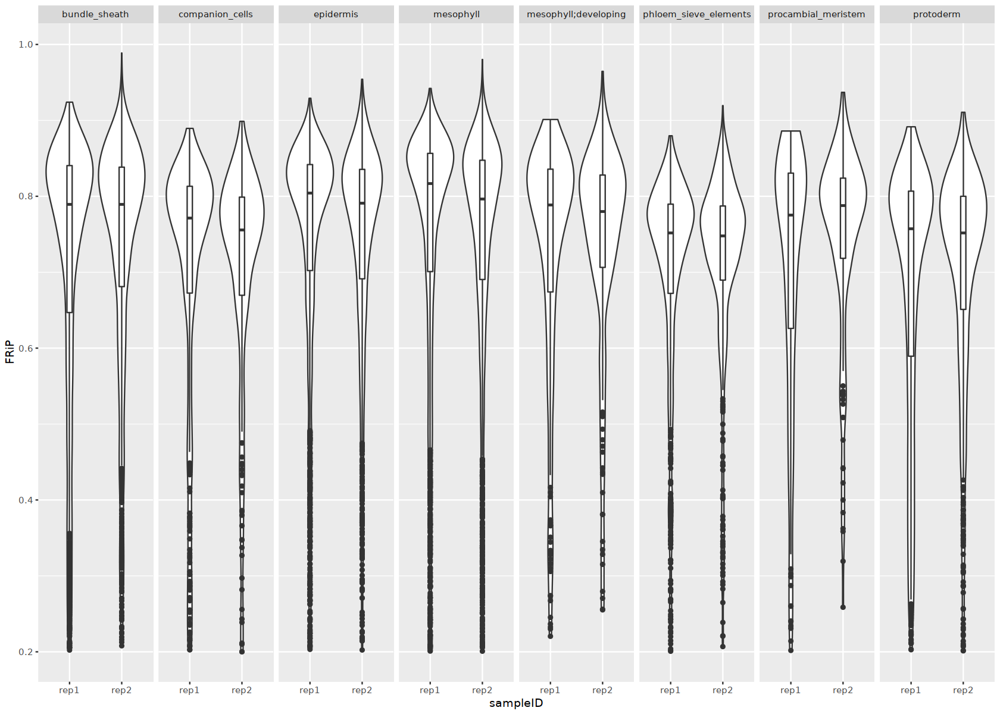

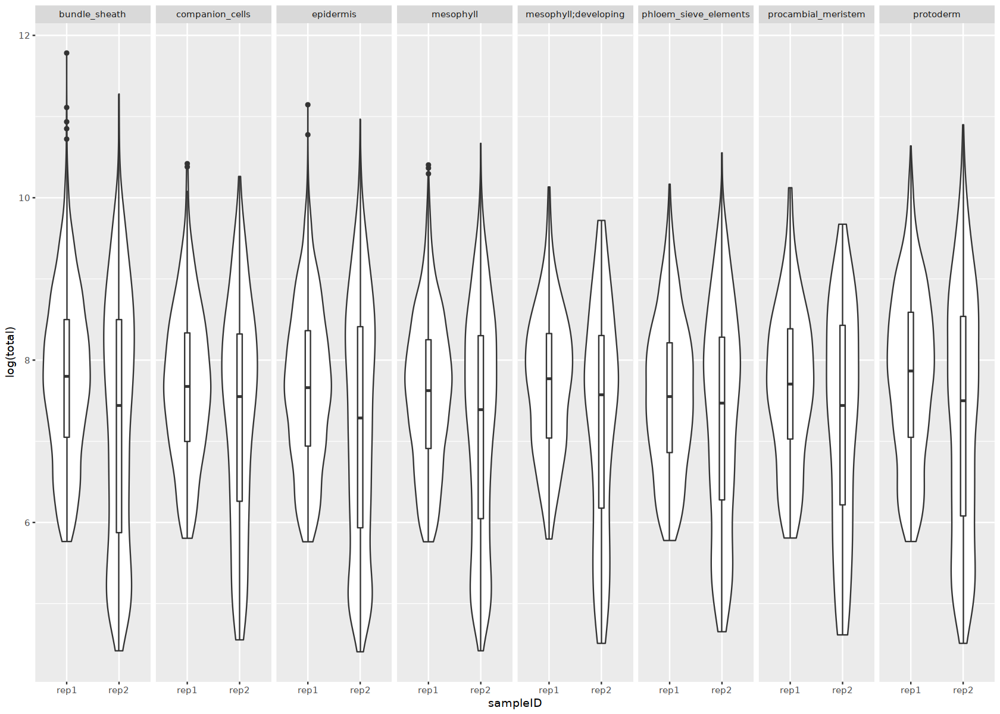

In [55]:
options(repr.plot.width=14, repr.plot.height=10)

zm_metadata  %>% 
    ggplot(., aes(x = sampleID, y = FRiP)) + 
    geom_violin() +
    geom_boxplot(width=0.1) + facet_grid(.~final_annotation)


zm_metadata  %>% 
    ggplot(., aes(x = sampleID, y = log(total))) + 
    geom_violin() +
    geom_boxplot(width=0.1) + facet_grid(.~final_annotation)

# 4/12/2023 Null Dist

In [3]:
### Zm
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge_split_rep1.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge_split_rep2.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge_split_rep1.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge_split_rep2.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(cts_acc,ctr_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- cts_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

Rows: 8536 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 7815 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 10629 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
ch

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr10,84946537,84947038,"scACR_10002;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","0.0942468166734153,0.0238074409376531"
chr10,85116996,85117497,"scACR_10010;epidermis_n_cell_3488,mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","0.0344978710185502,0.0108457592313035,0.00173212553519813"
chr10,85201314,85201815,"scACR_10013;epidermis_n_cell_3488,mesophyll_n_cell_4657,protoderm_n_cell_2021","0.000863430930760537,0.0434499549047726,0.0610975276461409"
chr10,85435095,85435596,"scACR_10018;epidermis_n_cell_3488,mesophyll_n_cell_4657","0.0301087751069519,0.0490840078959929"
chr10,85496289,85496790,"scACR_10020;epidermis_n_cell_3488,protoderm_n_cell_2021","3.18985664661263e-05,0.00225766824383499"
chr10,85730476,85730977,"scACR_10027;epidermis_n_cell_3488,procambial_meristem_n_cell_346","0.0260813065869384,0.0774365995350639"


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


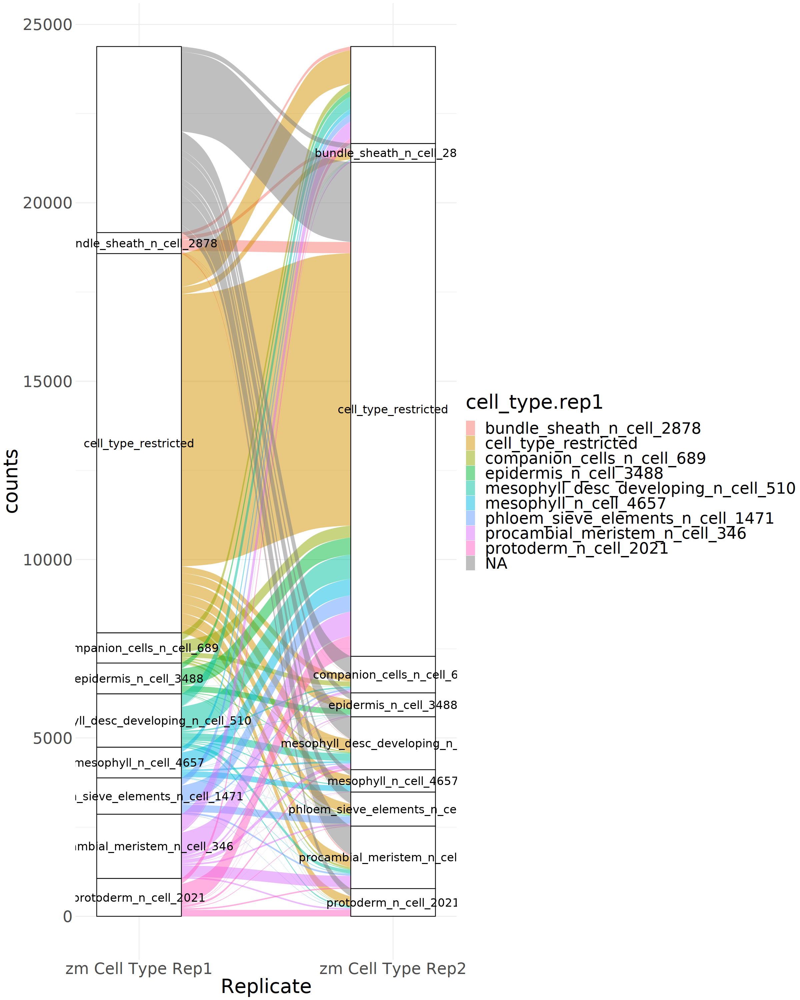

In [4]:
library(ggalluvial)
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


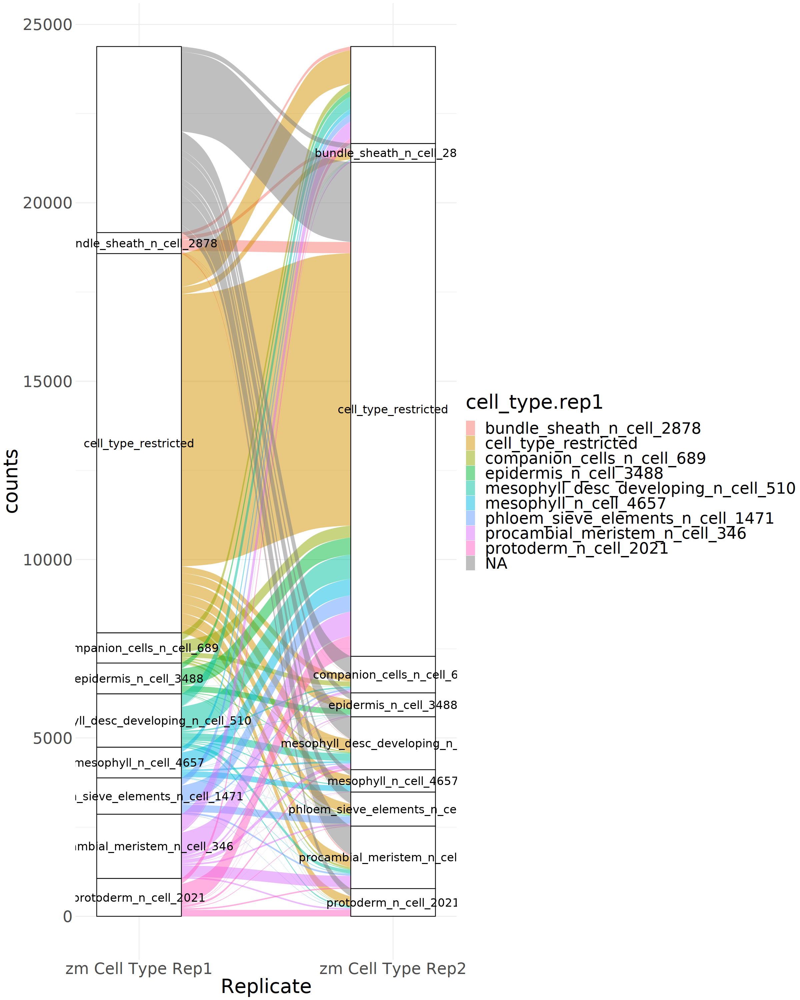

In [5]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [15]:
count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")#  %>% 
        #mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        #mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

In [19]:
zm_cts_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.replicate_intersection.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.replicate_intersection.cell_type_restricted.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.replicate_intersection.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_merged_rep_counts <- count_function(zm_broadly_acc_acrs_pool_file,zm_ctr_acrs_pool_file,zm_cts_acrs_pool_file)


zm_combined_rep <- zm_merged_rep_counts  %>% 
    group_by(cell_type)  %>% 
    summarise(counts_n_acrs = n())
zm_combined_rep

zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())


zm_switching_quant

Rows: 1471 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 12953 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 40235 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chro

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,40235
bundle_sheath_n_cell_2878,103
cell_type_restricted,12953
companion_cells_n_cell_689,135
epidermis_n_cell_3488,164
mesophyll_desc_developing_n_cell_510,210
mesophyll_n_cell_4657,160
phloem_sieve_elements_n_cell_1471,203
procambial_meristem_n_cell_346,316


classification,counts
<chr>,<int>
conserved,9104
switching,15276


In [35]:
zm_switching_quant_ct <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    group_by(cell_type.rep1, cell_type.rep2)  %>% 
    summarise(counts = n())#  %>% 
    #dplyr::filter(cell_type.rep1 == cell_type.rep2)  %>% 
    #ungroup()  %>% 
    #left_join(., zm_combined_rep, by = c("cell_type.rep1" = "cell_type"))  %>% 
    #mutate(proportion_conserved = counts/counts_n_acrs)

zm_switching_quant_ct

`summarise()` has grouped output by 'cell_type.rep1'. You can override using the `.groups` argument.


cell_type.rep1,cell_type.rep2,counts
<chr>,<chr>,<int>
bundle_sheath_n_cell_2878,bundle_sheath_n_cell_2878,134
bundle_sheath_n_cell_2878,cell_type_restricted,124
bundle_sheath_n_cell_2878,companion_cells_n_cell_689,1
bundle_sheath_n_cell_2878,epidermis_n_cell_3488,1
bundle_sheath_n_cell_2878,mesophyll_desc_developing_n_cell_510,7
bundle_sheath_n_cell_2878,mesophyll_n_cell_4657,7
bundle_sheath_n_cell_2878,phloem_sieve_elements_n_cell_1471,4
bundle_sheath_n_cell_2878,procambial_meristem_n_cell_346,7
bundle_sheath_n_cell_2878,protoderm_n_cell_2021,1


In [ ]:
x <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))

x  %>% 
    filter(classification == "switching") %>% 
    sample_n(50)

zm_metadata <- read_delim("/home/jpm73279/Mendieta_et_al_comparative_single_cell/metrics/annotations/Zm_annot_final/Zm.leaf_annot.V5.meta.frozen.txt")

colnames(zm_metadata)

# 4/14/2023 Quantifying Switching Between Replicates - Null distribution and Replicate normalization...  

Rows: 5564 Columns: 5
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 6514 Columns: 5
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 2909 Columns: 5
── Column specification ──────────────────────────

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr1,287017075,287017576,"scACR_7717;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","1.87883534943878e-08,0.000814425502465182"
chr9,43977615,43978116,"scACR_51557;epidermis_n_cell_3488,mesophyll_desc_developing_n_cell_510,protoderm_n_cell_2021","0.00177673883635728,1.46432413054294e-06,5.79970662869196e-06"
chr9,148415159,148415660,"scACR_53866;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","1.03239859240365e-05,3.13212072455685e-09"
chr5,120409138,120409639,"scACR_33542;mesophyll_n_cell_4657,protoderm_n_cell_2021","5.89208711493327e-06,0.000510910117775511"
chr9,131315152,131315653,"scACR_53196;bundle_sheath_n_cell_2878,procambial_meristem_n_cell_346","0.000526184565454592,2.73385466991472e-10"
chr4,248938150,248938651,"scACR_30338;epidermis_n_cell_3488,procambial_meristem_n_cell_346","0.000688038996789063,2.19213982261512e-06"


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


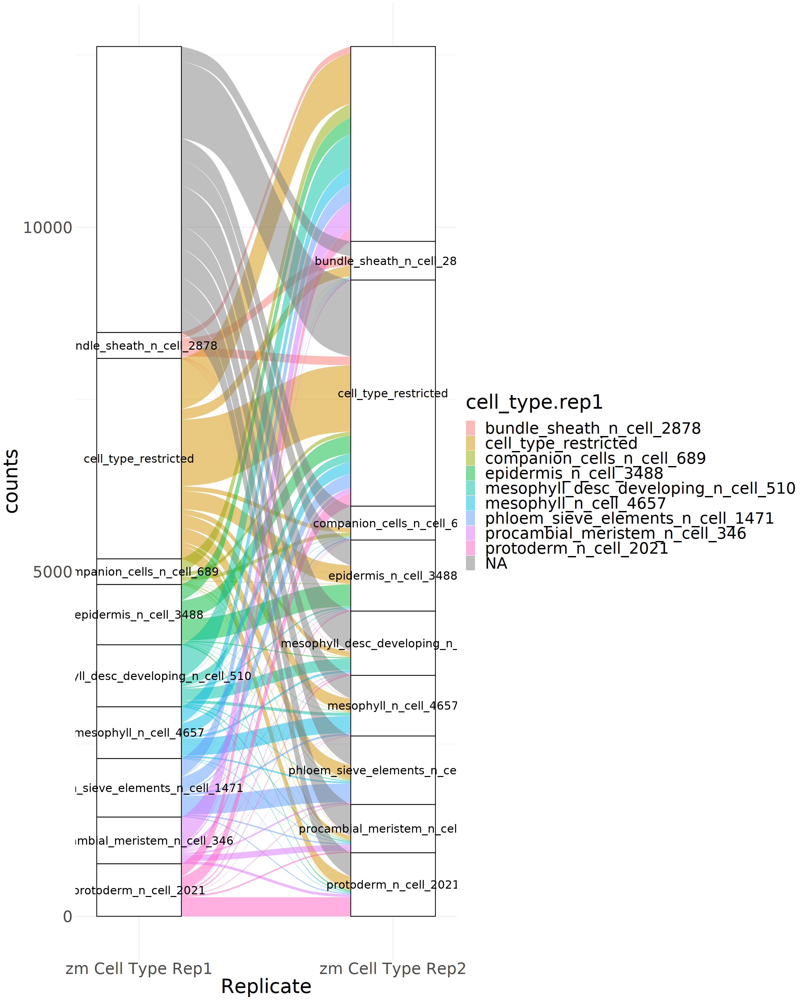

In [13]:
### Zm
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR_split_rep1.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR_split_rep2.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR_split_rep1.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR_split_rep2.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(cts_acc,ctr_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- cts_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

library(ggalluvial)
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


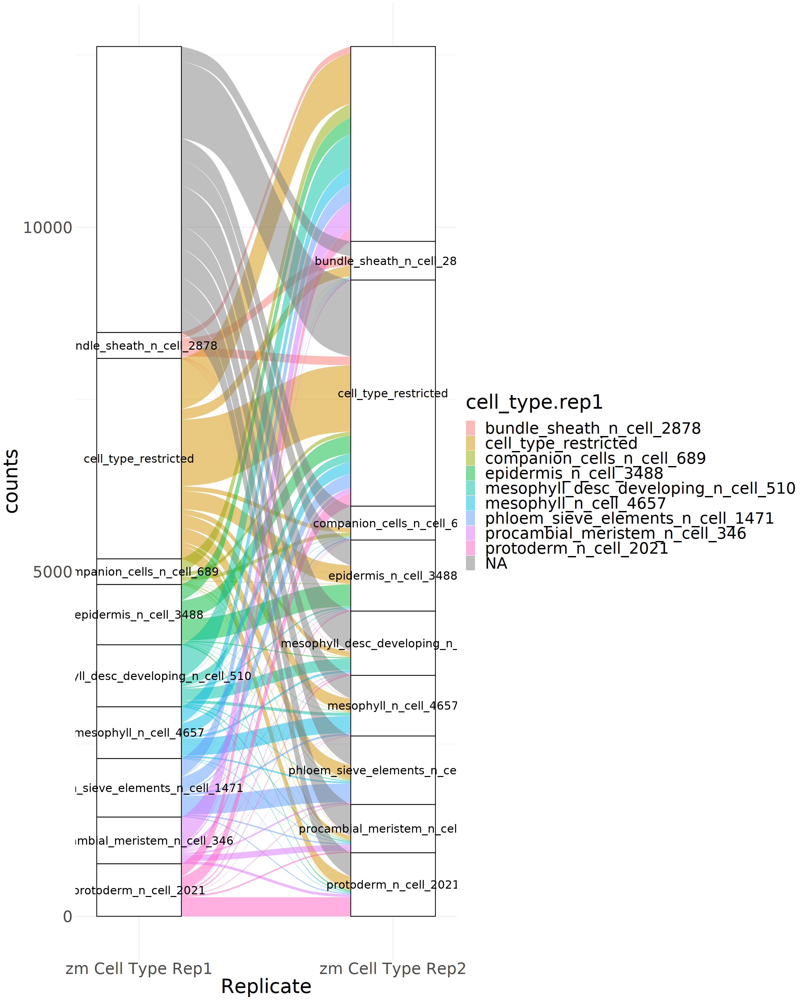

In [15]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [21]:
count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")#  %>% 
        #mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        #mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_cts_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.replicate_intersection.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.replicate_intersection.cell_type_restricted.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.replicate_intersection.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_merged_rep_counts <- count_function(zm_broadly_acc_acrs_pool_file,zm_ctr_acrs_pool_file,zm_cts_acrs_pool_file)


zm_combined_rep <- zm_merged_rep_counts  %>% 
    group_by(cell_type)  %>% 
    summarise(counts_n_acrs = n())
zm_combined_rep

Rows: 1560 Columns: 4
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 3949 Columns: 4
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 49150 Columns: 4
── Column specification ─────────────────────────────────────

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,49150
bundle_sheath_n_cell_2878,134
cell_type_restricted,3949
companion_cells_n_cell_689,57
epidermis_n_cell_3488,318
mesophyll_desc_developing_n_cell_510,167
mesophyll_n_cell_4657,247
phloem_sieve_elements_n_cell_1471,269
procambial_meristem_n_cell_346,90


In [22]:
zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())


zm_switching_quant

classification,counts
<chr>,<int>
conserved,2522
switching,10100


In [23]:
zm_combined_rep

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,49150
bundle_sheath_n_cell_2878,134
cell_type_restricted,3949
companion_cells_n_cell_689,57
epidermis_n_cell_3488,318
mesophyll_desc_developing_n_cell_510,167
mesophyll_n_cell_4657,247
phloem_sieve_elements_n_cell_1471,269
procambial_meristem_n_cell_346,90


In [31]:
str(zm_acrs_rep1)
str(zm_acrs_rep2)

tibble [8,473 × 7] (S3: tbl_df/tbl/data.frame)
 $ chrom    : chr [1:8473] "chr1" "chr2" "chr1" "chr9" ...
 $ start    : num [1:8473] 4.09e+07 1.11e+08 1.97e+08 1.36e+08 9.96e+07 ...
 $ stop     : num [1:8473] 4.09e+07 1.11e+08 1.97e+08 1.36e+08 9.96e+07 ...
 $ acr      : chr [1:8473] "scACR_1707" "scACR_15294" "scACR_4813" "scACR_53361" ...
 $ cell_type: chr [1:8473] "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" ...
 $ pval     : Factor w/ 8473 levels "1.41199689226711e-20",..: 1136 2286 876 4092 940 2500 923 3451 4751 670 ...
 $ rep      : chr [1:8473] "rep1" "rep1" "rep1" "rep1" ...
tibble [9,795 × 7] (S3: tbl_df/tbl/data.frame)
 $ chrom    : chr [1:9795] "chr2" "chr8" "chr1" "chr3" ...
 $ start    : num [1:9795] 4.95e+07 5.35e+06 2.29e+08 1.57e+08 2.23e+07 ...
 $ stop     : num [1:9795] 4.95e+07 5.36e+06 2.29e+08 1.57e+08 2.23e+07 ...
 $ acr      : chr [1:9795] "scACR_14367" "scACR_45927" "scACR_5845" "scACR_21730" ..

In [32]:
zm_switching_quant_ct <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    group_by(cell_type.rep1, cell_type.rep2)  %>% 
    summarise(counts = n())  %>% 
    dplyr::filter(cell_type.rep1 == cell_type.rep2)  %>% 
    ungroup()  %>% 
    left_join(., zm_combined_rep, by = c("cell_type.rep1" = "cell_type"))  %>% 
    mutate(proportion_conserved = counts/counts_n_acrs)

zm_switching_quant_ct

`summarise()` has grouped output by 'cell_type.rep1'. You can override using the `.groups` argument.


cell_type.rep1,cell_type.rep2,counts,counts_n_acrs,proportion_conserved
<chr>,<chr>,<int>,<int>,<dbl>
bundle_sheath_n_cell_2878,bundle_sheath_n_cell_2878,134,134,1.000000
cell_type_restricted,cell_type_restricted,962,3949,0.243606
companion_cells_n_cell_689,companion_cells_n_cell_689,57,57,1.000000
epidermis_n_cell_3488,epidermis_n_cell_3488,318,318,1.000000
mesophyll_desc_developing_n_cell_510,mesophyll_desc_developing_n_cell_510,167,167,1.000000
mesophyll_n_cell_4657,mesophyll_n_cell_4657,247,247,1.000000
phloem_sieve_elements_n_cell_1471,phloem_sieve_elements_n_cell_1471,269,269,1.000000
procambial_meristem_n_cell_346,procambial_meristem_n_cell_346,90,90,1.000000
protoderm_n_cell_2021,protoderm_n_cell_2021,278,278,1.000000


In [19]:
x <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))

x  %>% 
    filter(classification == "switching") %>% 
    sample_n(50)

zm_metadata <- read_delim("/home/jpm73279/Mendieta_et_al_comparative_single_cell/metrics/annotations/Zm_annot_final/Zm.leaf_annot.V5.meta.frozen.txt")

colnames(zm_metadata)

Rows: 1560 Columns: 4
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 3949 Columns: 4
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 54659 Columns: 4
── Column specification ─────────────────────────────────────

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,49150
bundle_sheath_n_cell_2878,268
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689",31
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,epidermis_n_cell_3488",1
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,mesophyll_desc_developing_n_cell_510",7
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,mesophyll_n_cell_4657",4
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,phloem_sieve_elements_n_cell_1471",20
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,procambial_meristem_n_cell_346",22
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,protoderm_n_cell_2021",5


classification,counts
<chr>,<int>
conserved,2522
switching,10100


`summarise()` has grouped output by 'cell_type.rep1'. You can override using the `.groups` argument.


cell_type.rep1,cell_type.rep2,counts,counts_n_acrs,proportion_conserved
<chr>,<chr>,<int>,<int>,<dbl>
bundle_sheath_n_cell_2878,bundle_sheath_n_cell_2878,134,268,0.500000
cell_type_restricted,cell_type_restricted,962,3949,0.243606
companion_cells_n_cell_689,companion_cells_n_cell_689,57,114,0.500000
epidermis_n_cell_3488,epidermis_n_cell_3488,318,636,0.500000
mesophyll_desc_developing_n_cell_510,mesophyll_desc_developing_n_cell_510,167,334,0.500000
mesophyll_n_cell_4657,mesophyll_n_cell_4657,247,494,0.500000
phloem_sieve_elements_n_cell_1471,phloem_sieve_elements_n_cell_1471,269,538,0.500000
procambial_meristem_n_cell_346,procambial_meristem_n_cell_346,90,180,0.500000
protoderm_n_cell_2021,protoderm_n_cell_2021,278,556,0.500000


chrom,start,stop,acr,cell_type.rep1,pval.rep1,rep.rep1,cell_type.rep2,pval.rep2,rep.rep2,classification
<chr>,<dbl>,<dbl>,<chr>,<chr>,<fct>,<chr>,<chr>,<fct>,<chr>,<chr>
chr8,124520548,124521049,scACR_48250,cell_type_restricted,"0.000285274034344866,0.000276073920142243",rep1,NA,NA,NA,switching
chr2,60131497,60131998,scACR_14584,procambial_meristem_n_cell_346,0.00092124249247843,rep1,phloem_sieve_elements_n_cell_1471,0.0015421734795329,rep2,switching
chr1,77742152,77742653,scACR_2784,mesophyll_desc_developing_n_cell_510,0.000751300345036,rep1,NA,NA,NA,switching
chr1,217080793,217081294,scACR_5486,phloem_sieve_elements_n_cell_1471,1.62546277625256e-09,rep1,mesophyll_n_cell_4657,1.82545975021057e-10,rep2,switching
chr3,212114684,212115185,scACR_23740,NA,NA,NA,mesophyll_n_cell_4657,0.0004602935083729,rep2,switching
chr3,27086955,27087456,scACR_19667,epidermis_n_cell_3488,0.00010539252883496,rep1,NA,NA,NA,switching
chr9,153572932,153573433,scACR_54125,NA,NA,NA,cell_type_restricted,"0.000299821486673203,0.00138638529882472",rep2,switching
chr5,14330796,14331297,scACR_31232,mesophyll_desc_developing_n_cell_510,0.00178969633823784,rep1,NA,NA,NA,switching
chr6,130949800,130950301,scACR_39050,phloem_sieve_elements_n_cell_1471,0.00082898330429375,rep1,cell_type_restricted,"2.27735821190954e-06,5.39664823655542e-14,0.00114484224220524",rep2,switching


Rows: 16060 Columns: 34
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (13): cellID, sampleID, d.type, Zm_v4_annot, Zm_v4_annot.subcluster_anno...
dbl (21): total, tss, acrs, ptmt, nSites, log10nSites, pTSS, FRiP, pOrg, tss...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] "cellID"                       "total"                       
 [3] "tss"                          "acrs"                        
 [5] "ptmt"                         "nSites"                      
 [7] "log10nSites"                  "pTSS"                        
 [9] "FRiP"                         "pOrg"                        
[11] "tss_z"                        "acr_z"                       
[13] "sites_z"                      "qc_check"                    
[15] "background"                   "cellbulk"                    
[17] "is_cell"                      "sampleID"                    
[19] "umap1"                        "umap2"                       
[21] "doubletscore"                 "d.type"                      
[23] "ptmt_ratio"                   "LouvainClusters"             
[25] "Zm_v4_annot"                  "Zm_v4_annot.subcluster_annot"
[27] "Zm.vasculature_lc"            "Zm.epidermis_lc"             
[29] "Zm.mesophyll_lc"              "v4_annotation_n"             
[31] "final_annotation_safe"        "final_annotation"            
[33] "reduce_resolution_annotation" "final_annotation_n"

In [20]:
zm_combined_rep

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,49150
bundle_sheath_n_cell_2878,268
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689",31
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,epidermis_n_cell_3488",1
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,mesophyll_desc_developing_n_cell_510",7
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,mesophyll_n_cell_4657",4
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,phloem_sieve_elements_n_cell_1471",20
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,procambial_meristem_n_cell_346",22
"bundle_sheath_n_cell_2878,companion_cells_n_cell_689,protoderm_n_cell_2021",5


# Quantifying Difference of scACR Assignment when Using Log

In [5]:
# 4/17/2023

### Zm
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log_split_rep1.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log_split_rep2.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log_split_rep1.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log_split_rep2.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(cts_acc,ctr_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- cts_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

Rows: 2721 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 3052 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 5944 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr6,142286335,142286836,"scACR_39370;bundle_sheath_n_cell_2878,epidermis_n_cell_3488,protoderm_n_cell_2021","0.000902349600342676,0.00202161550636306,0.000388229707944041"
chr10,104154956,104155457,"scACR_10448;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","0.00346790298967655,0.000762145841278378"
chr4,246209250,246209751,"scACR_30202;bundle_sheath_n_cell_2878,mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657","0.00143437756104556,0.0038249149918189,0.00229016378529295"
chr5,19600884,19601385,"scACR_31439;mesophyll_desc_developing_n_cell_510,protoderm_n_cell_2021","5.95618385280154e-05,0.00532012678746099"
chr5,177442674,177443175,"scACR_34577;epidermis_n_cell_3488,mesophyll_desc_developing_n_cell_510,protoderm_n_cell_2021","0.0001791358271893,3.40460870448731e-05,2.06184764616982e-06"
chr6,175343713,175344214,"scACR_40876;bundle_sheath_n_cell_2878,companion_cells_n_cell_689,procambial_meristem_n_cell_346","2.64500449174993e-06,0.0016837572527132,4.17226506483837e-05"


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.


Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


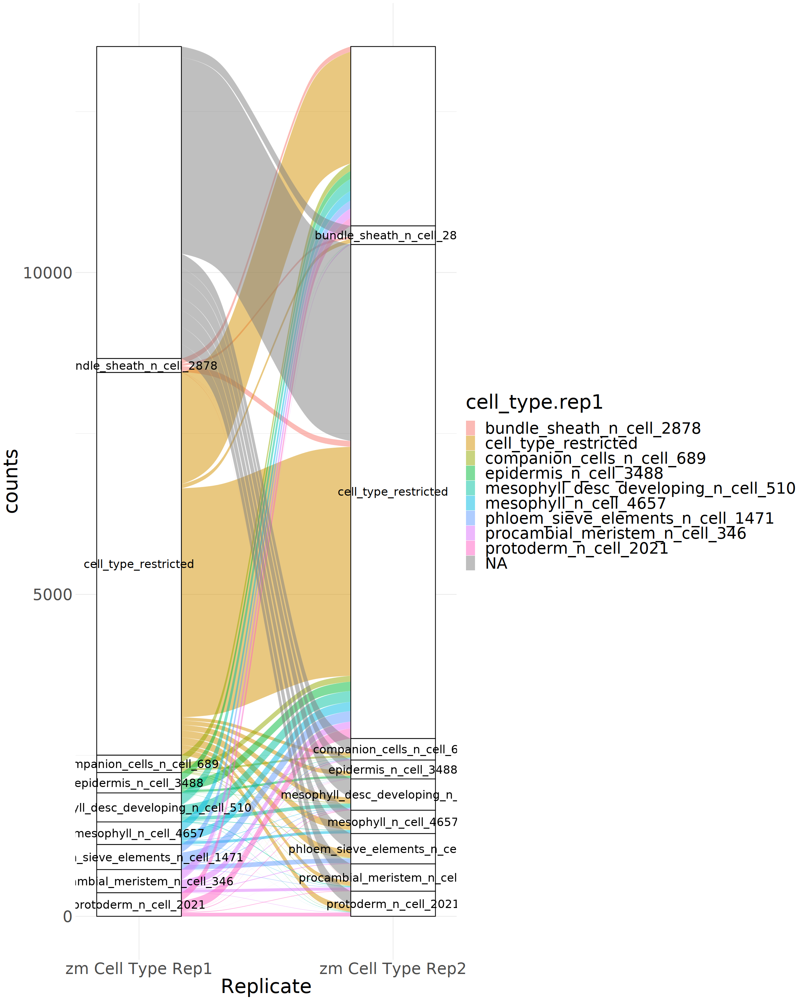

In [6]:
library(ggalluvial)
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


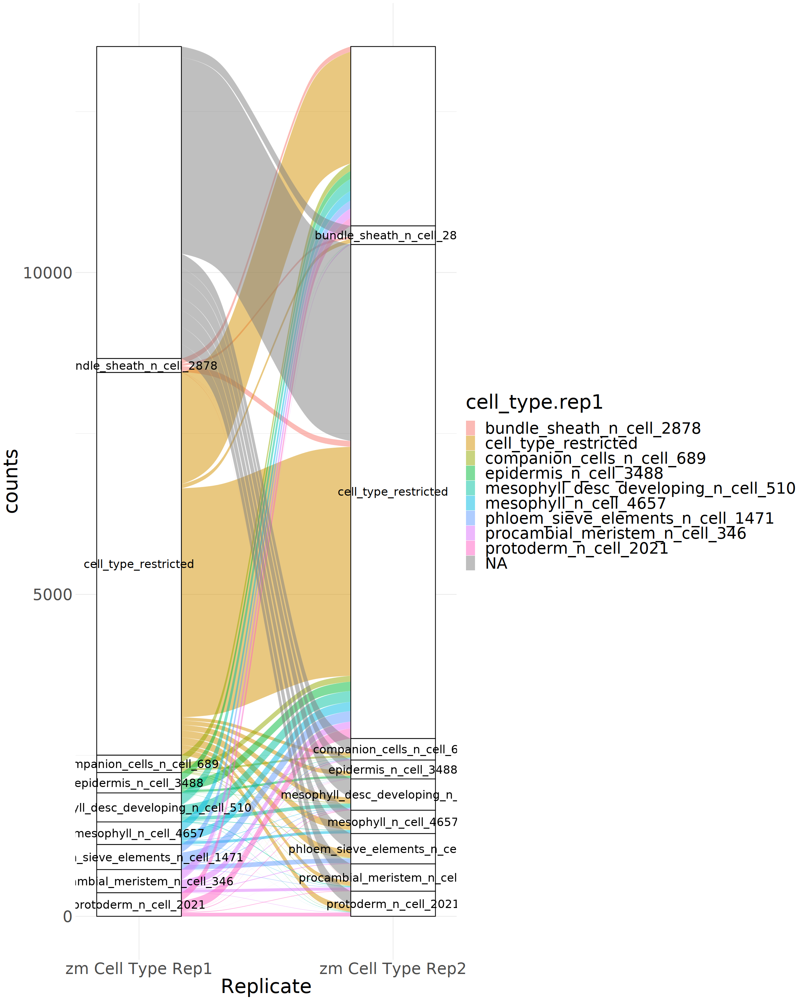

In [7]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [8]:
count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")#  %>% 
        #mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        #mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_cts_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log.replicate_intersection.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log.replicate_intersection.cell_type_restricted.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.log.replicate_intersection.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_merged_rep_counts <- count_function(zm_broadly_acc_acrs_pool_file,zm_ctr_acrs_pool_file,zm_cts_acrs_pool_file)


zm_combined_rep <- zm_merged_rep_counts  %>% 
    group_by(cell_type)  %>% 
    summarise(counts_n_acrs = n())
zm_combined_rep

zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())

zm_switching_quant

Rows: 373 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 4046 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 50240 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom,

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,50240
bundle_sheath_n_cell_2878,37
cell_type_restricted,4046
companion_cells_n_cell_689,30
epidermis_n_cell_3488,35
mesophyll_desc_developing_n_cell_510,56
mesophyll_n_cell_4657,42
phloem_sieve_elements_n_cell_1471,72
procambial_meristem_n_cell_346,46


classification,counts
<chr>,<int>
conserved,3930
switching,9580


In [9]:
zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())


zm_switching_quant

zm_combined_rep

str(zm_acrs_rep1)
str(zm_acrs_rep2)

zm_switching_quant_ct <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    group_by(cell_type.rep1, cell_type.rep2)  %>% 
    summarise(counts = n())  %>% 
    dplyr::filter(cell_type.rep1 == cell_type.rep2)  %>% 
    ungroup()  %>% 
    left_join(., zm_combined_rep, by = c("cell_type.rep1" = "cell_type"))  %>% 
    mutate(proportion_conserved = counts/counts_n_acrs)

zm_switching_quant_ct

classification,counts
<chr>,<int>
conserved,3930
switching,9580


cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,50240
bundle_sheath_n_cell_2878,37
cell_type_restricted,4046
companion_cells_n_cell_689,30
epidermis_n_cell_3488,35
mesophyll_desc_developing_n_cell_510,56
mesophyll_n_cell_4657,42
phloem_sieve_elements_n_cell_1471,72
procambial_meristem_n_cell_346,46


tibble [8,665 × 7] (S3: tbl_df/tbl/data.frame)
 $ chrom    : chr [1:8665] "chr7" "chr3" "chr3" "chr1" ...
 $ start    : num [1:8665] 3.12e+07 2.19e+07 1.77e+08 4.09e+07 1.38e+08 ...
 $ stop     : num [1:8665] 3.12e+07 2.19e+07 1.77e+08 4.09e+07 1.38e+08 ...
 $ acr      : chr [1:8665] "scACR_41934" "scACR_19508" "scACR_22288" "scACR_1707" ...
 $ cell_type: chr [1:8665] "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" ...
 $ pval     : Factor w/ 8665 levels "9.87951269352766e-18",..: 1572 2561 1779 1077 2484 1629 2438 1797 198 1253 ...
 $ rep      : chr [1:8665] "rep1" "rep1" "rep1" "rep1" ...
tibble [10,725 × 7] (S3: tbl_df/tbl/data.frame)
 $ chrom    : chr [1:10725] "chr1" "chr3" "chr5" "chr9" ...
 $ start    : num [1:10725] 2.95e+07 2.25e+08 1.95e+08 1.12e+08 1.38e+08 ...
 $ stop     : num [1:10725] 2.95e+07 2.25e+08 1.95e+08 1.12e+08 1.38e+08 ...
 $ acr      : chr [1:10725] "scACR_1255" "scACR_24372" "scACR_35238" "scACR_

`summarise()` has grouped output by 'cell_type.rep1'. You can override using the `.groups` argument.


cell_type.rep1,cell_type.rep2,counts,counts_n_acrs,proportion_conserved
<chr>,<chr>,<int>,<int>,<dbl>
bundle_sheath_n_cell_2878,bundle_sheath_n_cell_2878,37,37,1.0000000
cell_type_restricted,cell_type_restricted,3557,4046,0.8791399
companion_cells_n_cell_689,companion_cells_n_cell_689,30,30,1.0000000
epidermis_n_cell_3488,epidermis_n_cell_3488,35,35,1.0000000
mesophyll_desc_developing_n_cell_510,mesophyll_desc_developing_n_cell_510,56,56,1.0000000
mesophyll_n_cell_4657,mesophyll_n_cell_4657,42,42,1.0000000
phloem_sieve_elements_n_cell_1471,phloem_sieve_elements_n_cell_1471,72,72,1.0000000
procambial_meristem_n_cell_346,procambial_meristem_n_cell_346,46,46,1.0000000
protoderm_n_cell_2021,protoderm_n_cell_2021,55,55,1.0000000


In [ ]:
join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))

x  %>% 
    filter(classification == "switching") %>% 
    sample_n(50)

zm_metadata <- read_delim("/home/jpm73279/Mendieta_et_al_comparative_single_cell/metrics/annotations/Zm_annot_final/Zm.leaf_annot.V5.meta.frozen.txt")

colnames(zm_metadata)

# Working on FDR Corrected Data:

Rows: 2689 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 2942 Columns: 5
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (3): start, stop, pval

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 5940 Columns: 5
── Column specification ────────────────────────────

chrom,start,stop,acr_name_type,pval
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr2,41596158,41596659,"scACR_14142;mesophyll_n_cell_4657,phloem_sieve_elements_n_cell_1471","0.0621722087033644,0.0358706799018854"
chr3,113493779,113494280,"scACR_20836;mesophyll_desc_developing_n_cell_510,mesophyll_n_cell_4657,protoderm_n_cell_2021","0.0254380310909719,0.0157698414570835,0.0159416957919527"
chr9,134399730,134400231,"scACR_53303;companion_cells_n_cell_689,epidermis_n_cell_3488,protoderm_n_cell_2021","0.0170656149425784,0.000946057936934576,0.00050206037376229"
chr9,66535569,66536070,"scACR_51786;epidermis_n_cell_3488,protoderm_n_cell_2021","3.78685554724799e-06,5.74382742647994e-07"
chr1,71568602,71569103,"scACR_2642;epidermis_n_cell_3488,protoderm_n_cell_2021","0.00956449989185049,0.0195921798520956"
chr6,167901358,167901859,"scACR_40430;epidermis_n_cell_3488,protoderm_n_cell_2021","0.00555014142508348,0.00848105526146343"


`summarise()` has grouped output by 'cell_type.rep1', 'rep.rep1', 'cell_type.rep2'. You can override using the `.groups` argument.
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


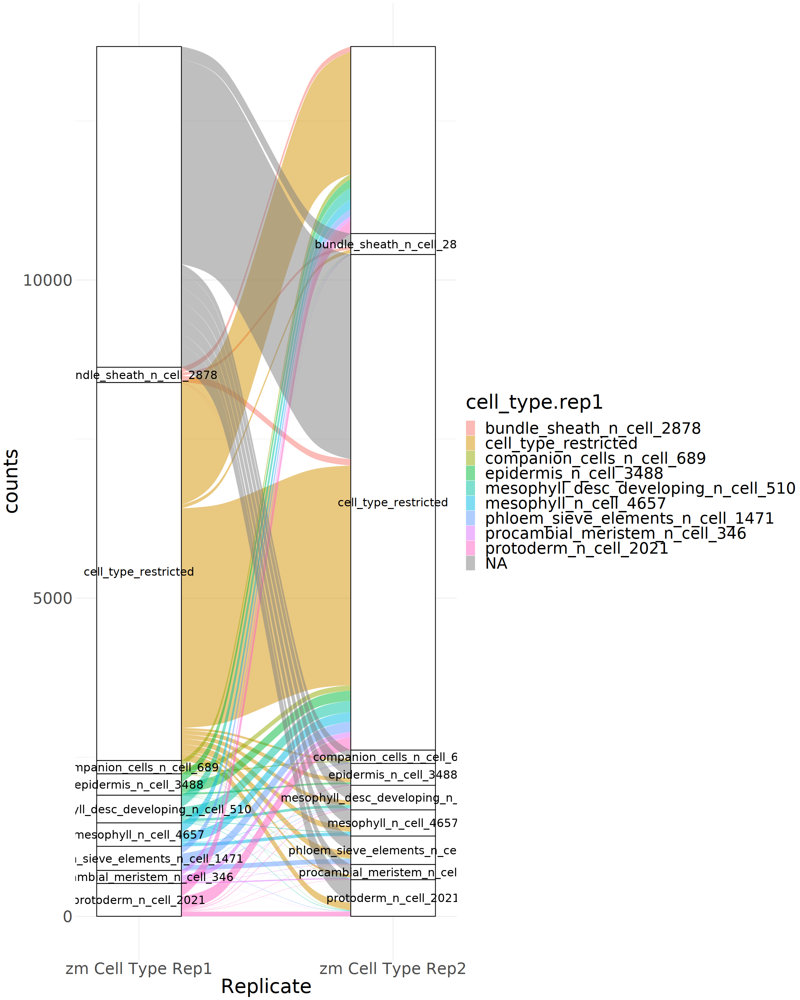

In [14]:
# 4/17/2023

### Zm
bed_col_names <- c("chrom", "start", "stop", "acr_name_type", "pval")
broadly <- c("chrom", "start", "stop", "score", "acr_name_type")
zm_cts_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR_split_rep1.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_cts_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR_split_rep2.all_cts.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR_split_rep1.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR_split_rep2.all_ctr.ACRs.bed",delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep1_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep1.upatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
#zm_broadly_acc_acrs_rep2_file <- read_delim("/scratch/jpm73279/comparative_single_cell/07.call.ACRs/replicate_analysis_one_off/zm/Zm.final_acr_classification.rep2.updatedbroadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)

head(zm_ctr_acrs_rep1_file)

count_function <- function(cts_acc,ctr_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")  %>% 
        mutate_at(vars(pval),factor)
    
    combined_vals <- cts_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_acrs_rep1 <- count_function(zm_cts_acrs_rep1_file,zm_ctr_acrs_rep1_file)  %>% 
    mutate(rep = "rep1")
zm_acrs_rep2 <- count_function(zm_cts_acrs_rep2_file, zm_ctr_acrs_rep2_file)  %>% 
    mutate(rep = "rep2")

joined_zm_replicates <- full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    group_by(cell_type.rep1, rep.rep1, cell_type.rep2, rep.rep2)  %>% 
    summarise(counts = n())

library(ggalluvial)
options(repr.plot.width=20, repr.plot.height=25)
ggplot(data = joined_zm_replicates,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”
Warning message in to_lodes_form(data = data, axes = axis_ind, discern = params$discern):
“Some strata appear at multiple axes.”


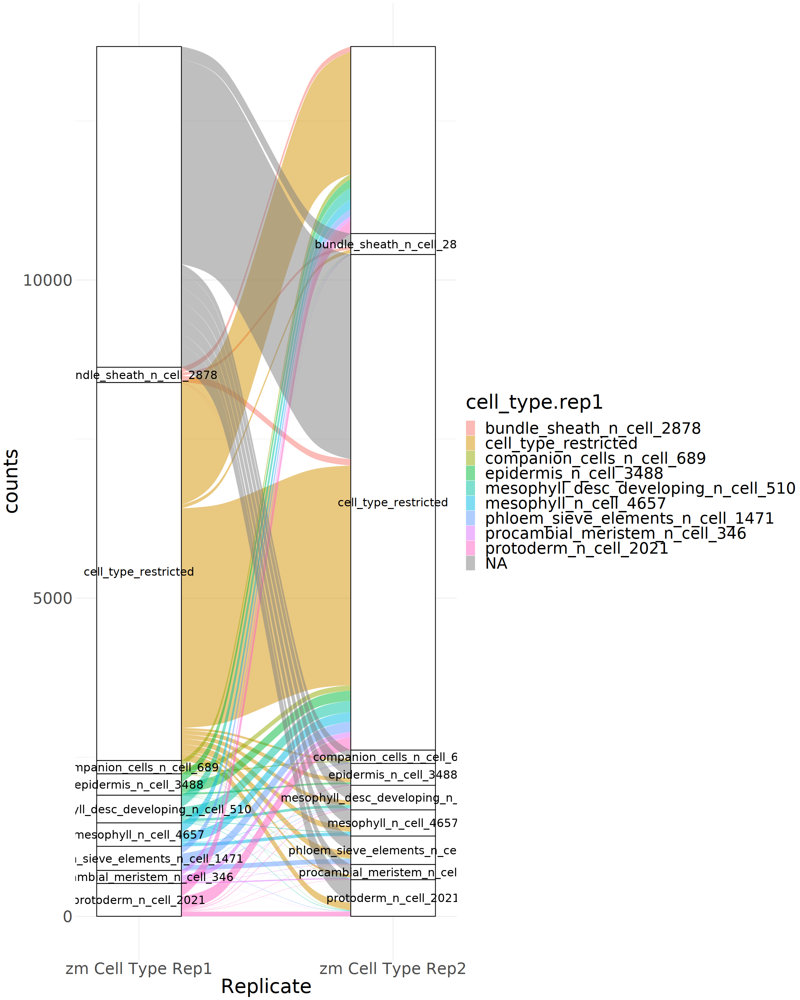

In [15]:
options(repr.plot.width=20, repr.plot.height=25) 
joined_zm_replicates  %>% 
    dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
ggplot(data = .,
       aes(axis1 = cell_type.rep1, axis2 = cell_type.rep2,
           y = counts)) +
  scale_x_discrete(limits = c("zm Cell Type Rep1", "zm Cell Type Rep2"), expand = c(.2, .05)) +
  xlab("Replicate") +
  geom_alluvium(aes(fill = cell_type.rep1)) +
  geom_stratum() +
  geom_text(size=7, stat = "stratum", aes(label = after_stat(stratum))) +
  theme_minimal() + theme(text = element_text(size = 35))

In [16]:
count_function <- function(broadly_acc, ctr_acc, cts_acc) {
    
    ctr_acc_fixed_named <- ctr_acc  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        mutate(cell_type = "cell_type_restricted")#  %>% 
        #mutate_at(vars(pval),factor)
    
    combined_vals <- bind_rows(broadly_acc, cts_acc)  %>% 
        tidyr::separate(acr_name_type, c("acr", "cell_type"), sep = ";")  %>% 
        #mutate_at(vars(pval),factor)  %>% 
        bind_rows(ctr_acc_fixed_named)
    
    return(combined_vals)
    
}

zm_cts_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR.replicate_intersection.all_cts.ACRs.bed", delim = "\t", col_names = bed_col_names)
zm_ctr_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR.replicate_intersection.cell_type_restricted.ACRs.bed",delim = "\t", col_names = bed_col_names)
zm_broadly_acc_acrs_pool_file <- read_delim("/scratch/jpm73279/comparative_single_cell/dev_location/entropy_calc.CTs/updated/testing_replicate_merge.normalization_edgeR.FDR.replicate_intersection.broadly_accessible.ACRs.bed" ,delim = "\t", col_names = bed_col_names)
zm_merged_rep_counts <- count_function(zm_broadly_acc_acrs_pool_file,zm_ctr_acrs_pool_file,zm_cts_acrs_pool_file)


zm_combined_rep <- zm_merged_rep_counts  %>% 
    group_by(cell_type)  %>% 
    summarise(counts_n_acrs = n())
zm_combined_rep

zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())

zm_switching_quant

zm_switching_quant <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    dplyr::group_by(classification)  %>% 
    summarise(counts = n())


zm_switching_quant

zm_combined_rep

str(zm_acrs_rep1)
str(zm_acrs_rep2)

zm_switching_quant_ct <-  full_join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))  %>% 
    group_by(cell_type.rep1, cell_type.rep2)  %>% 
    summarise(counts = n())  %>% 
    dplyr::filter(cell_type.rep1 == cell_type.rep2)  %>% 
    ungroup()  %>% 
    left_join(., zm_combined_rep, by = c("cell_type.rep1" = "cell_type"))  %>% 
    mutate(proportion_conserved = counts/counts_n_acrs)

zm_switching_quant_ct

join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", "acr"),
                        suffix = c(".rep1", ".rep2"))  %>%
    #dplyr::filter(cell_type.rep1 != "broadly_accessible" | cell_type.rep2 != "broadly_accessible") %>% 
    dplyr::mutate(classification = case_when(cell_type.rep1 == cell_type.rep2 ~ "conserved",
                                     TRUE ~ "switching"))

x  %>% 
    filter(classification == "switching") %>% 
    sample_n(50)

zm_metadata <- read_delim("/home/jpm73279/Mendieta_et_al_comparative_single_cell/metrics/annotations/Zm_annot_final/Zm.leaf_annot.V5.meta.frozen.txt")

colnames(zm_metadata)

Rows: 358 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 2701 Columns: 4
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (2): chrom, acr_name_type
dbl (2): start, stop

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 51600 Columns: 4
── Column specification ────────────────────────────────────────

cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,51600
bundle_sheath_n_cell_2878,47
cell_type_restricted,2701
companion_cells_n_cell_689,19
epidermis_n_cell_3488,28
mesophyll_desc_developing_n_cell_510,42
mesophyll_n_cell_4657,52
phloem_sieve_elements_n_cell_1471,75
procambial_meristem_n_cell_346,21


classification,counts
<chr>,<int>
conserved,3809
switching,9860


classification,counts
<chr>,<int>
conserved,3809
switching,9860


cell_type,counts_n_acrs
<chr>,<int>
broadly_accessible,51600
bundle_sheath_n_cell_2878,47
cell_type_restricted,2701
companion_cells_n_cell_689,19
epidermis_n_cell_3488,28
mesophyll_desc_developing_n_cell_510,42
mesophyll_n_cell_4657,52
phloem_sieve_elements_n_cell_1471,75
procambial_meristem_n_cell_346,21


tibble [8,629 × 7] (S3: tbl_df/tbl/data.frame)
 $ chrom    : chr [1:8629] "chr2" "chr5" "chr3" "chr5" ...
 $ start    : num [1:8629] 1.61e+08 1.96e+07 1.30e+08 2.21e+08 4.89e+07 ...
 $ stop     : num [1:8629] 1.61e+08 1.96e+07 1.30e+08 2.21e+08 4.89e+07 ...
 $ acr      : chr [1:8629] "scACR_15998" "scACR_31436" "scACR_21168" "scACR_36421" ...
 $ cell_type: chr [1:8629] "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" "bundle_sheath_n_cell_2878" ...
 $ pval     : Factor w/ 8479 levels "2.36875430416888e-14",..: 623 348 948 1905 278 188 740 449 1154 1200 ...
 $ rep      : chr [1:8629] "rep1" "rep1" "rep1" "rep1" ...
tibble [10,730 × 7] (S3: tbl_df/tbl/data.frame)
 $ chrom    : chr [1:10730] "chr3" "chr6" "chr3" "chr5" ...
 $ start    : num [1:10730] 1.71e+08 8.82e+07 5.66e+07 1.80e+08 1.26e+08 ...
 $ stop     : num [1:10730] 1.71e+08 8.82e+07 5.66e+07 1.80e+08 1.26e+08 ...
 $ acr      : chr [1:10730] "scACR_22079" "scACR_37952" "scACR_20283" "scACR_3470

`summarise()` has grouped output by 'cell_type.rep1'. You can override using the `.groups` argument.


cell_type.rep1,cell_type.rep2,counts,counts_n_acrs,proportion_conserved
<chr>,<chr>,<int>,<int>,<dbl>
bundle_sheath_n_cell_2878,bundle_sheath_n_cell_2878,47,47,1.000000
cell_type_restricted,cell_type_restricted,3451,2701,1.277675
companion_cells_n_cell_689,companion_cells_n_cell_689,19,19,1.000000
epidermis_n_cell_3488,epidermis_n_cell_3488,28,28,1.000000
mesophyll_desc_developing_n_cell_510,mesophyll_desc_developing_n_cell_510,42,42,1.000000
mesophyll_n_cell_4657,mesophyll_n_cell_4657,52,52,1.000000
phloem_sieve_elements_n_cell_1471,phloem_sieve_elements_n_cell_1471,75,75,1.000000
procambial_meristem_n_cell_346,procambial_meristem_n_cell_346,21,21,1.000000
protoderm_n_cell_2021,protoderm_n_cell_2021,74,74,1.000000


ERROR: Error in join(zm_acrs_rep1, zm_acrs_rep2, by = c("chrom", "start", "stop", : could not find function "join"
